## Predicting Energy consumption in NYC

A Data-Driven Approach to Sustainable Urban Living

Datasets: https://data.cityofnewyork.us/Environment/NYC-Building-Energy-and-Water-Data-Disclosure-for-/5zyy-y8am/about_data / https://www.nyc.gov/site/planning/data-maps/open-data/dwn-pluto-mappluto.page


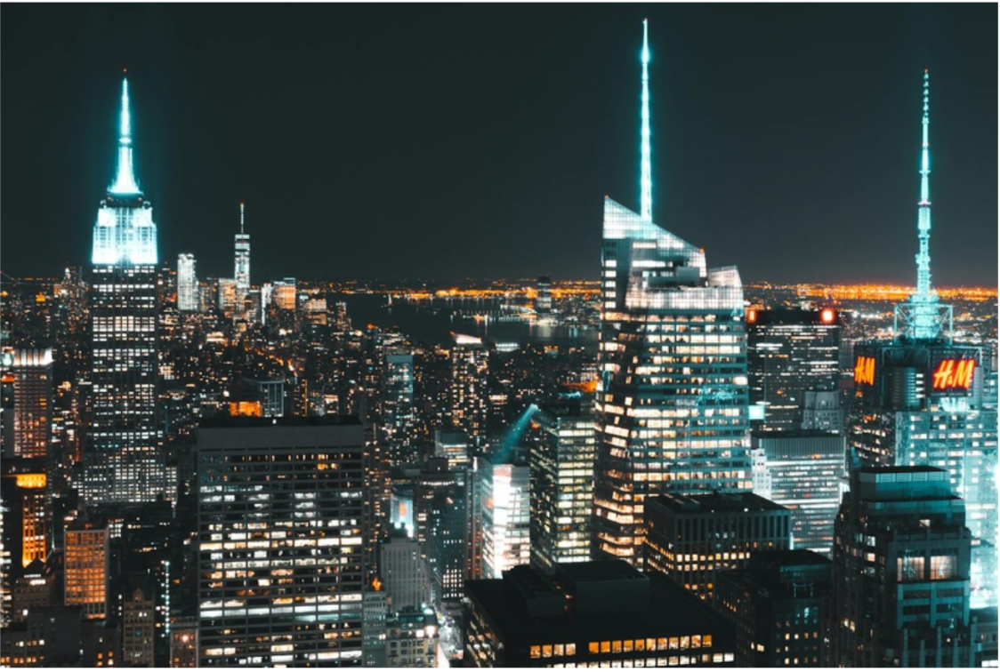

## Business Understanding:
This initiative revolves around the comprehensive analysis and prediction of energy consumption in New York City buildings, aligning closely with broader business motivations and objectives. The project aims to deliver valuable outcomes for a diverse range of stakeholders, including urban planners, environmentalists, the New York State Government, real estate investors, and policymakers.

Our primary business objectives are to offer useful insights that directly impact energy-efficient building practices, influence the creation of policies supporting sustainable living, and lead to cost savings for individuals and businesses. By utilizing advanced machine learning models to predict energy efficiency trends, our project aims to guide decisions that optimize resource usage, reduce environmental impact, and support economic development. Ultimately, we want to contribute to the overall resilience of the community.

The alignment of business motivations with model objectives ensures that the predictions and insights from our models have practical implications, supporting broader goals such as promoting sustainability, informing policy decisions, and creating a resilient and energy-efficient urban environment.

## Project’s Technical Objectives
In this project, our primary goal is to assess the ability to predict total energy consumption in buildings using only indirect factors, such as building size, occupancy, and other related parameters. By employing advanced machine learning models, we aim to understand how well these non-direct energy measures can serve as reliable predictors for overall energy usage. Initially, bigger buildings, taller buildings, and higher occupancy all show positive correlations. But the question arises: how well can we predict these factors?

Our secondary objective is to identify buildings that deviate significantly from our predictions. Buildings consuming more energy than anticipated may be considered inefficient, prompting the exploration of recommendations for energy reduction. On the other hand, identifying buildings that consume less energy than predicted provides an opportunity for further study. Analyzing these energy-efficient buildings can yield insights into practices that contribute to lower consumption, ultimately allowing us to develop targeted recommendations for broader energy efficiency improvements


## Data Understanding

This project leverages two key datasets: The NYC Building Energy for Local Law 84 (2023-Present), providing information on energy usage for buildings exceeding 50,000 square feet, including details such as year built, address, and occupancy. Additionally, the Primary Land Use Tax Lot Output (PLUTO™) data file offers comprehensive land use and geographic data, featuring columns like address, number of buildings, number of floors, etc. The selection of these datasets are based on their extensive information content, with PLUTO™ comprising over 800,000 rows and 92 columns, and the NYC dataset containing 30,000 rows and 254 columns. Directly sourced from official websites, these datasets encompass diverse features, including building energy consumption, water usage, land use, zoning, building characteristics, and geographic information. Our study stands out for its unique approach to integrating these datasets, potentially offering valuable insights into the field of urban energy efficiency analysis.


In [1]:
# Importing the needed libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.dummy import DummyRegressor
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.metrics import mean_squared_error, accuracy_score, r2_score,make_scorer
from sklearn.preprocessing import FunctionTransformer, OneHotEncoder

from sklearn.ensemble import RandomForestRegressor

import xgboost as xgb

from sklearn.model_selection import GridSearchCV



## Data exploration

* The Primary Land Use Tax Lot Output (PLUTO™) dataset

In [2]:
#Reading The Primary Land Use Tax Lot Output (PLUTO™) dataset
df1=pd.read_csv('data/pluto_23v3_1.csv',low_memory=False)

In [3]:
#checkiing the shape()
df1.shape

(858598, 92)

In [4]:
#checking the first 5 rows
df1.head()

,borough,block,lot,cd,bct2020,bctcb2020,ct2010,cb2010,schooldist,council,...,appbbl,appdate,plutomapid,firm07_flag,pfirm15_flag,version,dcpedited,latitude,longitude,notes
0,BX,5595,94,210.0,2013200.0,2.013201e+10,132.0,5008.0,8.0,13.0,...,NaN,NaN,1,NaN,NaN,23v3.1,NaN,40.814154,-73.820936,NaN
1,BX,5593,98,210.0,2013200.0,2.013201e+10,132.0,5006.0,8.0,13.0,...,NaN,NaN,1,NaN,1.0,23v3.1,NaN,40.814429,-73.819393,NaN
2,BX,5593,106,210.0,2013200.0,2.013201e+10,132.0,5006.0,8.0,13.0,...,NaN,NaN,1,NaN,1.0,23v3.1,NaN,40.814896,-73.819695,NaN
3,BX,5593,103,210.0,2013200.0,2.013201e+10,132.0,5006.0,8.0,13.0,...,NaN,NaN,1,1.0,1.0,23v3.1,NaN,40.814706,-73.819580,NaN
4,BX,5593,101,210.0,2013200.0,2.013201e+10,132.0,5006.0,8.0,13.0,...,NaN,NaN,1,1.0,1.0,23v3.1,NaN,40.814577,-73.819504,NaN


In [5]:
df1.isna().sum()

borough           0
block             0
lot               0
cd              943
bct2020         997
              ...  
version           0
dcpedited    816447
latitude       1049
longitude      1049
notes        858598
Length: 92, dtype: int64

In [6]:
#checking the columns info
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 858598 entries, 0 to 858597
Data columns (total 92 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   borough               858598 non-null  object 
 1   block                 858598 non-null  int64  
 2   lot                   858598 non-null  int64  
 3   cd                    857655 non-null  float64
 4   bct2020               857601 non-null  float64
 5   bctcb2020             857601 non-null  float64
 6   ct2010                857601 non-null  float64
 7   cb2010                857601 non-null  float64
 8   schooldist            856929 non-null  float64
 9   council               857513 non-null  float64
 10  zipcode               856914 non-null  float64
 11  firecomp              856910 non-null  object 
 12  policeprct            856924 non-null  float64
 13  healthcenterdistrict  856924 non-null  float64
 14  healtharea            856924 non-null  float64
 15  

In [7]:
# Identify columns with data type 'object'
object_columns = df1.select_dtypes(include='object').columns
num_object_columns = len(object_columns)

# Identify columns with data type 'float' or 'int'
numeric_columns = df1.select_dtypes(include=['float', 'int']).columns
num_numeric_columns = len(numeric_columns)

# Print the counts
print(f"Number of columns with data type 'object': {num_object_columns}")
print(f"Number of columns with data type 'float' or 'int': {num_numeric_columns}")

Number of columns with data type 'object': 28
Number of columns with data type 'float' or 'int': 64


In [8]:
# Extract the specified columns
selected_columns = ['borough','block', 'zipcode', 'address', 'bldgarea', 'landuse', 'lotarea', 'comarea', 'resarea', 'bldgclass']
exp_df1 = df1[selected_columns]

# Display the first few rows of the selected columns
exp_df1.head()

,borough,block,zipcode,address,bldgarea,landuse,lotarea,comarea,resarea,bldgclass
0,BX,5595,10465.0,2737 SCHURZ AVENUE,1800.0,1.0,3000.0,0.0,1800.0,B1
1,BX,5593,10465.0,182 BRINSMADE AVENUE,2838.0,1.0,4600.0,0.0,1892.0,B1
2,BX,5593,10465.0,196 BRINSMADE AVENUE,2322.0,1.0,2342.0,0.0,1548.0,B1
3,BX,5593,10465.0,190 BRINSMADE AVENUE,2838.0,1.0,2742.0,0.0,1892.0,B1
4,BX,5593,10465.0,186 BRINSMADE AVENUE,2838.0,1.0,2742.0,0.0,1892.0,B1


In [9]:
exp_df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 858598 entries, 0 to 858597
Data columns (total 10 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   borough    858598 non-null  object 
 1   block      858598 non-null  int64  
 2   zipcode    856914 non-null  float64
 3   address    858240 non-null  object 
 4   bldgarea   858215 non-null  float64
 5   landuse    855837 non-null  float64
 6   lotarea    857622 non-null  float64
 7   comarea    811216 non-null  float64
 8   resarea    811216 non-null  float64
 9   bldgclass  858241 non-null  object 
dtypes: float64(6), int64(1), object(3)
memory usage: 65.5+ MB


In [10]:
#checking for missing values in df1
df1.isna().sum()

borough           0
block             0
lot               0
cd              943
bct2020         997
              ...  
version           0
dcpedited    816447
latitude       1049
longitude      1049
notes        858598
Length: 92, dtype: int64

In [11]:
# Calculate value counts for each column in exploration_df
for column in exp_df1.columns:
    print(f"Value counts for {column}:\n{exp_df1[column].value_counts()}\n")

Value counts for borough:
borough
QN    324534
BK    276470
SI    125252
BX     89563
MN     42779
Name: count, dtype: int64

Value counts for block:
block
2925     577
7405     539
4452     536
7422     485
869      412
        ... 
13378      1
15327      1
15922      1
12882      1
0          1
Name: count, Length: 13959, dtype: int64

Value counts for zipcode:
zipcode
10314.0    21009
10312.0    19455
11234.0    19391
10306.0    17035
11236.0    14682
           ...  
10122.0        1
10165.0        1
10170.0        1
10176.0        1
10152.0        1
Name: count, Length: 215, dtype: int64

Value counts for address:
address
500 WEST 18TH STREET    203
 HYLAN BOULEVARD        167
 ARTHUR KILL ROAD       154
 AMBOY ROAD             153
 RICHMOND TERRACE       144
                       ... 
261 WEST 113 STREET       1
253 WEST 113 STREET       1
227 WEST 113 STREET       1
267 WEST 113 STREET       1
342 AMSTERDAM AVENUE      1
Name: count, Length: 828131, dtype: int64

Value counts 

In [12]:
# Exploring the address column
df1['address'].value_counts()

address
500 WEST 18TH STREET    203
 HYLAN BOULEVARD        167
 ARTHUR KILL ROAD       154
 AMBOY ROAD             153
 RICHMOND TERRACE       144
                       ... 
261 WEST 113 STREET       1
253 WEST 113 STREET       1
227 WEST 113 STREET       1
267 WEST 113 STREET       1
342 AMSTERDAM AVENUE      1
Name: count, Length: 828131, dtype: int64

## Reading NYC Building energy

In [13]:
#reading NYC Building energy
df2=pd.read_csv('data/NYC_Building_Energy_and_Water_Data_Disclosure_for_Local_Law_84__2023-Present__20240129.csv',low_memory=False)

In [14]:
#checking the shape
df2.shape

(30485, 254)

In [15]:
#Reading df2.info()
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# Display DataFrame information in a structured format
print(f"<class 'pandas.core.frame.DataFrame'>")
print(f"RangeIndex: {df2.shape[0]} entries, 0 to {df2.shape[0] - 1}")
print("Data columns (total %d columns):" % df2.shape[1])

# Loop through columns and display information for each
for i, column in enumerate(df2.columns):
    print(f" #   {i:2d} {column:20s} {df2[column].count():>13d} non-null  {df2[column].dtype.name:<8s}")

# Display memory usage information
print(f"dtypes: {df2.dtypes.value_counts().to_string()}")
print(f"memory usage: {df2.memory_usage(deep=True).sum() / (1024**2):.1f}+ MB")

# Reset display options to default values
pd.reset_option('display.max_columns')
pd.reset_option('display.max_rows')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30485 entries, 0 to 30484
Data columns (total 254 columns):
 #    0 Report Year                  30485 non-null  int64   
 #    1 Property ID                  30485 non-null  int64   
 #    2 Property Name                30485 non-null  object  
 #    3 Parent Property ID           30485 non-null  object  
 #    4 Parent Property Name         30485 non-null  object  
 #    5 Year Ending                  30485 non-null  object  
 #    6 NYC Borough, Block and Lot (BBL)         30485 non-null  object  
 #    7 NYC Building Identification Number (BIN)         30485 non-null  object  
 #    8 Address 1                    30485 non-null  object  
 #    9 City                         30485 non-null  object  
 #   10 Postal Code                  30485 non-null  object  
 #   11 Primary Property Type - Self Selected         30485 non-null  object  
 #   12 Primary Property Type - Portfolio Manager-Calculated         30485 non-null  object  
 # 

In [16]:
#checking the head of the dataset 
df2.head()

,Report Year,Property ID,Property Name,Parent Property ID,Parent Property Name,Year Ending,"NYC Borough, Block and Lot (BBL)",NYC Building Identification Number (BIN),Address 1,City,...,Number of Active IT Meters,Report Generation Date,Report Submission Date,Borough,Latitude,Longitude,Community Board,Council District,Census Tract (2020),Neighborhood Tabulation Area (NTA) (2020)
0,2022,6414946,58-01 Grand Avenue,Not Applicable: Standalone Property,Not Applicable: Standalone Property,12/31/2022,4026780001,4059918,58-01 Grand Avenue,Queens,...,0,04/25/2023 11:01:44 AM,04/25/2023 11:02:08 AM,QUEENS,40.719667,-73.911197,405.0,30.0,531.0,QN0501
1,2022,9793770,1870 Pelham Parkway South,Not Applicable: Standalone Property,Not Applicable: Standalone Property,12/31/2022,2042500026,2047795,1870 Pelham Parkway South,Bronx,...,0,03/11/2023 02:00:50 PM,03/11/2023 02:01:08 PM,BRONX,40.855488,-73.830726,210.0,13.0,300.0,BX1003
2,2022,10177418,Central Building,Not Applicable: Standalone Property,Not Applicable: Standalone Property,12/31/2022,4157040040,4300145,2011 Mott Ave,Far Rockaway,...,0,04/14/2023 03:47:19 PM,04/14/2023 03:47:37 PM,QUEENS,40.604320,-73.753009,414.0,31.0,100803.0,QN1401
3,2022,13511507,215 East 99th Street,Not Applicable: Standalone Property,Not Applicable: Standalone Property,12/31/2022,1016490009,1052383,215 East 99th Street,New York,...,0,03/12/2023 03:54:23 PM,03/12/2023 03:54:43 PM,MANHATTAN,40.786963,-73.947537,111.0,8.0,164.0,MN1101
4,2022,14009907,23-25 31 Street,Not Applicable: Standalone Property,Not Applicable: Standalone Property,12/31/2022,4008350027,4017180,23-25 31 Street,Queens,...,0,04/28/2023 02:22:48 PM,04/28/2023 02:23:30 PM,QUEENS,40.773768,-73.913573,401.0,22.0,115.0,QN0101


In [17]:
# Identify columns with data type 'object'
object_columns = df2.select_dtypes(include='object').columns
num_object_columns = len(object_columns)

# Identify columns with data type 'float' or 'int'
numeric_columns = df2.select_dtypes(include=['float', 'int']).columns
num_numeric_columns = len(numeric_columns)

# Print the counts
print(f"Number of columns with data type 'object': {num_object_columns}")
print(f"Number of columns with data type 'float' or 'int': {num_numeric_columns}")

Number of columns with data type 'object': 233
Number of columns with data type 'float' or 'int': 19


In [18]:
# Calculate value counts for each column in df2
for column in df2.columns:
    print(f"Value counts for {column}:\n{df2[column].value_counts()}\n")

Value counts for Report Year:
Report Year
2022    30485
Name: count, dtype: int64

Value counts for Property ID:
Property ID
3001555     2
26713705    2
6670939     2
20023408    2
6808818     2
           ..
15527410    1
15526842    1
7468565     1
18196163    1
2681034     1
Name: count, Length: 30332, dtype: int64

Value counts for Property Name:
Property Name
Cross Bronx Pres LLC - Baychester (2166bay)    4
Main Building                                  3
University Center                              3
Cross Bronx Pres LLC - Murphy (2166murph)      3
150 West 26th Street                           3
                                              ..
2629 Sedgwick Avenue                           1
2323 Creston Avenue                            1
2239-41 Creston Avenue                         1
Putnam Avenue Cluster - 680 Jefferson Ave      1
Newlo Realty Company                           1
Name: count, Length: 30203, dtype: int64

Value counts for Parent Property ID:
Parent Property

In [19]:
# Count the missing values in each column of df2
df2.isna().sum()


Report Year                                     0
Property ID                                     0
Property Name                                   0
Parent Property ID                              0
Parent Property Name                            0
                                             ... 
Longitude                                    1101
Community Board                              1100
Council District                             1100
Census Tract (2020)                          1100
Neighborhood Tabulation Area (NTA) (2020)    1100
Length: 254, dtype: int64

In [20]:
# Convert column names to lowercase
df2.columns = [col.lower() for col in df2.columns]

#Convert the data set into lower case
df2 = df2.applymap(lambda x: x.lower() if isinstance(x, str) else x)
df2.head()

/var/folders/py/3n00xtn91530fm9swm7lpdx80000gp/T/ipykernel_72864/1536913436.py:5: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df2 = df2.applymap(lambda x: x.lower() if isinstance(x, str) else x)


,report year,property id,property name,parent property id,parent property name,year ending,"nyc borough, block and lot (bbl)",nyc building identification number (bin),address 1,city,...,number of active it meters,report generation date,report submission date,borough,latitude,longitude,community board,council district,census tract (2020),neighborhood tabulation area (nta) (2020)
0,2022,6414946,58-01 grand avenue,not applicable: standalone property,not applicable: standalone property,12/31/2022,4026780001,4059918,58-01 grand avenue,queens,...,0,04/25/2023 11:01:44 am,04/25/2023 11:02:08 am,queens,40.719667,-73.911197,405.0,30.0,531.0,qn0501
1,2022,9793770,1870 pelham parkway south,not applicable: standalone property,not applicable: standalone property,12/31/2022,2042500026,2047795,1870 pelham parkway south,bronx,...,0,03/11/2023 02:00:50 pm,03/11/2023 02:01:08 pm,bronx,40.855488,-73.830726,210.0,13.0,300.0,bx1003
2,2022,10177418,central building,not applicable: standalone property,not applicable: standalone property,12/31/2022,4157040040,4300145,2011 mott ave,far rockaway,...,0,04/14/2023 03:47:19 pm,04/14/2023 03:47:37 pm,queens,40.604320,-73.753009,414.0,31.0,100803.0,qn1401
3,2022,13511507,215 east 99th street,not applicable: standalone property,not applicable: standalone property,12/31/2022,1016490009,1052383,215 east 99th street,new york,...,0,03/12/2023 03:54:23 pm,03/12/2023 03:54:43 pm,manhattan,40.786963,-73.947537,111.0,8.0,164.0,mn1101
4,2022,14009907,23-25 31 street,not applicable: standalone property,not applicable: standalone property,12/31/2022,4008350027,4017180,23-25 31 street,queens,...,0,04/28/2023 02:22:48 pm,04/28/2023 02:23:30 pm,queens,40.773768,-73.913573,401.0,22.0,115.0,qn0101


# Summary: 
Exploring df1, it contains only 10 out of 92 columns with complete information. It has 28 columns of type object and 64 of type float or integer. Key columns of interest include borough, block, zipcode, address, building areas, land use, lot area, commercial area, residential area, building class, etc. A subset dataset, exp_df1, has been created for further exploration, revealing opportunities for data normalization such as converting strings to lowercase, particularly in the address column. Understanding the features and addressing the huge amount of zeros in columns like building area, commercial area, and residential area are essential steps.

df2 contains 233 columns with data type ‘object’ and 19 with data type float or integer. Key columns of interest include Property Id, Year Ending, NYC Borough, block and lot, City, Postal Code, Address 1, Primary Property Type, etc. Certain columns have missing values, and a value count has been conducted to explore each column.

## Merging using address columns in both datasets

Before creating a merged dataset named df_a_m using the address column as a key, normalization steps will be taken, converting all string values to lowercase. Manual cleaning will be applied to key columns for better integration.

In [21]:
#Convert the data set into lower case
df1 = df1.applymap(lambda x: x.lower() if isinstance(x, str) else x);

/var/folders/py/3n00xtn91530fm9swm7lpdx80000gp/T/ipykernel_72864/725434735.py:2: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df1 = df1.applymap(lambda x: x.lower() if isinstance(x, str) else x);


In [22]:
#reviewing the address column for df1
df1[['address']]

,address
0,2737 schurz avenue
1,182 brinsmade avenue
2,196 brinsmade avenue
3,190 brinsmade avenue
4,186 brinsmade avenue
...,...
858593,18 kissam avenue
858594,jewett avenue
858595,40 holcomb avenue
858596,holden boulevard


In [23]:
# Manual Cleaning of df1 address
df1['address'] = df1['address'].str.replace('-', '')  # Remove '-'
df1['address'] = df1['address'].str.split('/').str[0].str.strip() # Remove '/'

In [24]:
#exploring df2 address column
df2['address 1']

0               58-01 grand avenue
1        1870 pelham parkway south
2                    2011 mott ave
3             215 east 99th street
4                  23-25 31 street
                   ...            
30480             163 front street
30481              15 lisbon place
30482                113-25 14 ave
30483               450 zerega ave
30484         347-349 rider avenue
Name: address 1, Length: 30485, dtype: object

In [25]:
# Manual Cleaning of df2 address
df2['address 1'] = df2['address 1'].str.replace('-', '')  # Remove '-'
df2['address 1'] = df2['address 1'].str.split('/').str[0].str.strip()  # Remove '/'

In [26]:
#Merging both datasets
df_m2 = pd.merge(df2, df1, left_on='address 1', right_on='address')
df_m2.shape

(9723, 346)

In [27]:
#Merging both datasets
df_m = pd.merge(df1, df2, left_on='address', right_on='address 1')
df_m.shape

(9723, 346)

In [28]:
#Exporting our dataset into a csv file
df_m.to_csv('df_a_m.csv', index=False)

## Data Preparation:

The project required extensive data preparation, involving tasks such as cleaning, merging datasets, and addressing missing values. The df_a_m dataset, stored in CSV format, posed challenges due to its large size and diverse data types, with dimensions of (9723, 346). The 'property id' column was used to eliminate duplicates, and data cleaning included the removal of entries based on this column and the cleaning of 'postal codes' by selecting only the first 5 digits. Some entries in metric columns were erroneously considered as objects/characters, leading to their conversion to numeric values for clarity. Visual tools like bar charts, scatter plots, and heatmaps were employed to enhance data understanding. A subset of the dataset, using features not related directly to energy consumption with site energy us as target, was created. 

Features: As we will see below, many features exhibited a skewed distribution, concentrating in low numbers with a "long tail" toward high values. To address this, we applied a Logarithm transformation to reduce skewness and normalize the dataset's distribution. This transformation specifically targeted columns identified as having this issue. Additionally, QQ plots were used to visually inspect whether the columns exhibited a normal distribution after the log transformation.

The steps mentioned above are crucial for solving the problem at hand. They ensure data integrity, reduce biases, and enhance interpretability in the context of result interpretation.



In [29]:

#reading the merged dataset
df_a_m = pd.read_csv('df_a_m.csv', low_memory=False);

In [30]:
#checking the shape
df_a_m.shape 

(9723, 346)

In [31]:
# checking the information of the columns

# Set display options
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# Display DataFrame information in a structured format
print(f"<class 'pandas.core.frame.DataFrame'>")
print(f"RangeIndex: {df_a_m.shape[0]} entries, 0 to {df_a_m.shape[0] - 1}")
print("Data columns (total %d columns):" % df_a_m.shape[1])

# Loop through columns and display information for each
for i, column in enumerate(df_a_m.columns):
    print(f" #   {i:2d} {column:20s} {df_a_m[column].count():>13d} non-null  {df_a_m[column].dtype.name:<8s}")

# Display memory usage information
print(f"dtypes: {df_a_m.dtypes.value_counts().to_string()}")
print(f"memory usage: {df_a_m.memory_usage(deep=True).sum() / (1024**2):.1f}+ MB")

# Reset display options to default values
pd.reset_option('display.max_columns')
pd.reset_option('display.max_rows')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9723 entries, 0 to 9722
Data columns (total 346 columns):
 #    0 borough_x                     9723 non-null  object  
 #    1 block                         9723 non-null  int64   
 #    2 lot                           9723 non-null  int64   
 #    3 cd                            9689 non-null  float64 
 #    4 bct2020                       9689 non-null  float64 
 #    5 bctcb2020                     9689 non-null  float64 
 #    6 ct2010                        9689 non-null  float64 
 #    7 cb2010                        9689 non-null  float64 
 #    8 schooldist                    9620 non-null  float64 
 #    9 council                       9679 non-null  float64 
 #   10 zipcode                       9620 non-null  float64 
 #   11 firecomp                      9620 non-null  object  
 #   12 policeprct                    9620 non-null  float64 
 #   13 healthcenterdistrict          9620 non-null  float64 
 #   14 healtharea      

In [32]:
#checking for duplicates in property id
df_a_m['property id'].duplicated().value_counts()

property id
False    9212
True      511
Name: count, dtype: int64

In [33]:
#Dropping for duplicates in property id
df_a_m = df_a_m.drop_duplicates(subset='property id')

In [34]:
#Sanity check 
df_a_m.shape 

(9212, 346)

In [35]:
#Reviewing the duplicates
df_a_m.duplicated().value_counts()

False    9212
Name: count, dtype: int64

In [36]:
# Normalize the 'postal code' column to the first 5 characters ( from values '10012-4411')
df_a_m['postal code'] = df_a_m['postal code'].str[:5]

# Verify the update
df_a_m['postal code'].unique()

array(['10461', '11101', '11106', '11102', '10025', '11205', '10011',
       '10010', '11418', '11215', '10001', '11103', '11104', '11211',
       '11377', '11435', '11434', '11433', '11232', '10027', '10016',
       '10017', '10006', '10024', '10455', '11228', '10463', '11209',
       '11217', '11218', '10018', '11238', '11432', '11368', '11373',
       '11423', '10475', '10028', '10023', '11229', '10022', '10456',
       '10301', '11374', '11365', '11436', '11355', '11354', '11427',
       '11249', '10034', '10014', '10013', '10002', '10012', '10004',
       '10003', '10459', '10470', '10309', '10038', '11201', '11237',
       '10453', '11235', '10040', '11109', '10452', '10473', '10036',
       '10019', '10165', '10065', '10021', '10172', '10167', '10171',
       '10466', '10075', '10170', '10033', '10302', '10177', '10173',
       '10465', '10128', '10035', '10026', '10029', '10031', '11206',
       '10037', '10454', '10009', '10472', '10007', '10451', '10474',
       '10306', '104

In [37]:
#checking the column for the missing values
df_a_m['postal code'].isna().sum()

0

In [38]:
#Column exploration
df_a_m['primary property type - self selected'].value_counts()

primary property type - self selected
multifamily housing           6680
office                         672
k-12 school                    429
hotel                          154
non-refrigerated warehouse     115
                              ... 
bar/nightclub                    1
convention center                1
other - specialty hospital       1
energy/power station             1
other - utility                  1
Name: count, Length: 65, dtype: int64

## Subsetting our Dataset creating df_e

In [39]:
# Selecting features
features = [  'lotarea', 'bldgarea', 'numfloors','unitstotal','assessland',
                                'largest property use type - gross floor area (ft²)',
                                  'year built', 'construction status', 'number of buildings', 'occupancy',
                                 'property gfa - self-reported (ft²)', 'postal code',
                                  'landuse','comarea','resarea','bldgdepth','lottype','bsmtcode','builtfar', 'residfar','commfar','facilfar'                         
                              ]

In [40]:
# For Energy Analysis
target = 'site energy use (kbtu)' 

# Creating the subset DataFrame for Energy analysis
df_e = df_a_m[features + [target]]

In [41]:
#checking the shape 
df_e.shape

(9212, 23)

In [42]:
#checking the nulls 
df_e.isna().sum()

lotarea                                                 1
bldgarea                                                0
numfloors                                             169
unitstotal                                              1
assessland                                              0
largest property use type - gross floor area (ft²)      0
year built                                              0
construction status                                     0
number of buildings                                     0
occupancy                                               0
property gfa - self-reported (ft²)                      0
postal code                                             0
landuse                                                 3
comarea                                               245
resarea                                               245
bldgdepth                                               1
lottype                                                 0
bsmtcode      

In [43]:
#Dropping the nulls
df_e=df_e.dropna()
df_e.shape

(8909, 23)

In [44]:
#checking the columns
df_e.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8909 entries, 0 to 9721
Data columns (total 23 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   lotarea                                             8909 non-null   float64
 1   bldgarea                                            8909 non-null   float64
 2   numfloors                                           8909 non-null   float64
 3   unitstotal                                          8909 non-null   float64
 4   assessland                                          8909 non-null   float64
 5   largest property use type - gross floor area (ft²)  8909 non-null   float64
 6   year built                                          8909 non-null   int64  
 7   construction status                                 8909 non-null   object 
 8   number of buildings                                 8909 non-null   int64  
 9   oc

In [45]:
#checking the head of our dataset 
df_e.head()

,lotarea,bldgarea,numfloors,unitstotal,assessland,largest property use type - gross floor area (ft²),year built,construction status,number of buildings,occupancy,...,comarea,resarea,bldgdepth,lottype,bsmtcode,builtfar,residfar,commfar,facilfar,site energy use (kbtu)
0,316180.0,153816.0,2.0,3.0,2133000.0,153816.0,1981,existing,1,100,...,153816.0,0.0,240.0,3.0,0.0,0.49,0.00,1.0,2.4,7996944.3
18,9000.0,35568.0,6.0,48.0,364500.0,38532.0,1940,existing,1,100,...,0.0,35568.0,90.0,3.0,0.0,3.95,1.25,0.0,2.0,739486.5
19,9313.0,29480.0,4.0,38.0,183150.0,29480.0,1937,existing,1,95,...,0.0,29480.0,93.0,3.0,0.0,3.17,3.00,0.0,3.0,3213156.2
20,30900.0,94250.0,6.0,125.0,599413.0,99600.0,1963,existing,1,100,...,2864.0,91386.0,0.0,5.0,5.0,3.05,3.00,0.0,3.0,4647605.3
22,102811.0,324023.0,19.0,414.0,3074434.0,424552.0,1961,existing,1,100,...,0.0,324023.0,72.0,5.0,5.0,3.15,3.44,0.0,6.5,27710965.3


In [46]:
# Identify object columns
object_columns = df_e.select_dtypes(include=['object']).columns
print(object_columns)

# List of columns to exclude
exclude_columns = ['borough_x', 'construction status', 'primary property type - self selected']

# Convert each object column to float, setting errors to NaN
for col in object_columns:
    if col not in exclude_columns:
        try:
            df_e[col] = df_e[col].astype(float)
        except ValueError:
            df_e.loc[:, col] = pd.to_numeric(df_e[col], errors='coerce')


Index(['construction status', 'postal code', 'site energy use (kbtu)'], dtype='object')


In [47]:
#converting our target into numeric
df_e['site energy use (kbtu)'] = pd.to_numeric(df_e['site energy use (kbtu)'], errors='coerce').astype(np.float64)

In [48]:
#Sanity check 
df_e.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8909 entries, 0 to 9721
Data columns (total 23 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   lotarea                                             8909 non-null   float64
 1   bldgarea                                            8909 non-null   float64
 2   numfloors                                           8909 non-null   float64
 3   unitstotal                                          8909 non-null   float64
 4   assessland                                          8909 non-null   float64
 5   largest property use type - gross floor area (ft²)  8909 non-null   float64
 6   year built                                          8909 non-null   int64  
 7   construction status                                 8909 non-null   object 
 8   number of buildings                                 8909 non-null   int64  
 9   oc

In [49]:
#Grouping the year built by group of 20

def map_year_built(year):
    if 1600 <= year <= 1899:
        return 1900
    elif 1901 <= year <= 1920:
        return 1920
    elif 1921 <= year <= 1940:
        return 1940
    elif 1941 <= year <= 1960:
        return 1960
    elif 1961 <= year <= 1980:
        return 1980
    elif 1981 <= year <= 2000:
        return 2000
    elif 2001 <= year <= 2023:
        return 2020
    else:
        return year  # If the year doesn't fall into any of the specified ranges

# Apply the mapping function to the 'year built' column using .loc
df_e.loc[:, 'year built'] = df_e['year built'].map(map_year_built)


In [50]:
#checking the values of year built column
df_e['year built'].value_counts()

year built
1940    3363
2020    1410
1960    1219
1920    1161
1980     943
2000     532
1900     281
Name: count, dtype: int64

In [51]:
#sanity check 
df_e.isna().sum()

lotarea                                                 0
bldgarea                                                0
numfloors                                               0
unitstotal                                              0
assessland                                              0
largest property use type - gross floor area (ft²)      0
year built                                              0
construction status                                     0
number of buildings                                     0
occupancy                                               0
property gfa - self-reported (ft²)                      0
postal code                                             0
landuse                                                 0
comarea                                                 0
resarea                                                 0
bldgdepth                                               0
lottype                                                 0
bsmtcode      

In [52]:
# lets drop the nan and the not available rows for kbtu/ft2
df_e= df_e[~df_e[target].isin(['not available', np.nan])]
df_e.isna().sum()

lotarea                                               0
bldgarea                                              0
numfloors                                             0
unitstotal                                            0
assessland                                            0
largest property use type - gross floor area (ft²)    0
year built                                            0
construction status                                   0
number of buildings                                   0
occupancy                                             0
property gfa - self-reported (ft²)                    0
postal code                                           0
landuse                                               0
comarea                                               0
resarea                                               0
bldgdepth                                             0
lottype                                               0
bsmtcode                                        

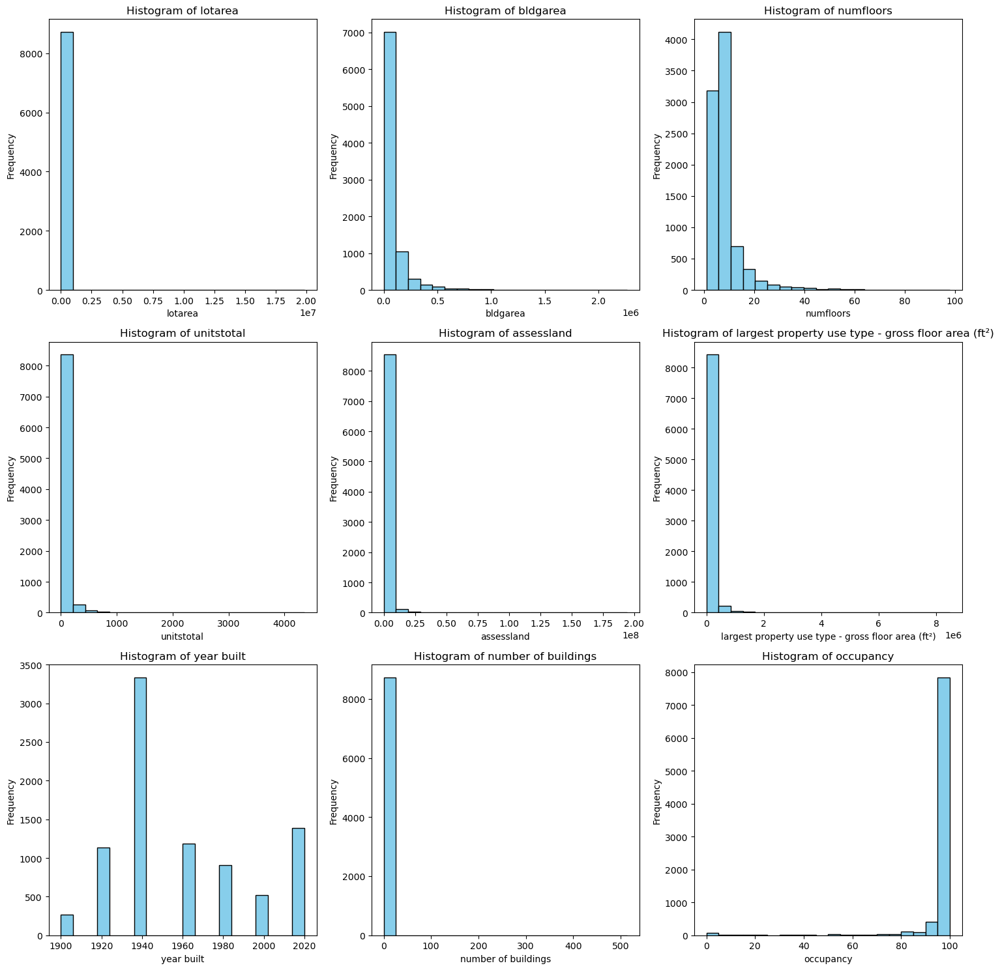

In [53]:

# Number of rows and columns in the grid
n_rows, n_cols = 3, 3

# Create a figure and a set of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 15))
axes = axes.flatten()  

# Plotting histograms for each numeric column
for i, column in enumerate(df_e.select_dtypes(include=np.number).columns):
    if i >= n_rows * n_cols:  
        break
    axes[i].hist(df_e[column], bins=20, color='skyblue', edgecolor='black')
    axes[i].set_title(f'Histogram of {column}')
    axes[i].set_xlabel(column)
    axes[i].set_ylabel('Frequency')

# Hide any unused subplots
for ax in axes[i+1:]:
    ax.remove()

plt.tight_layout()
plt.show()

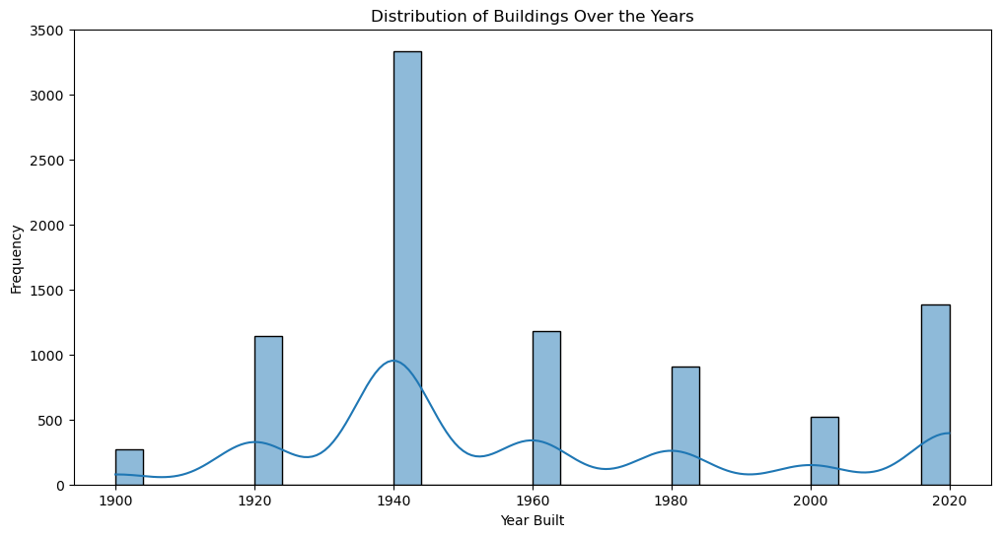

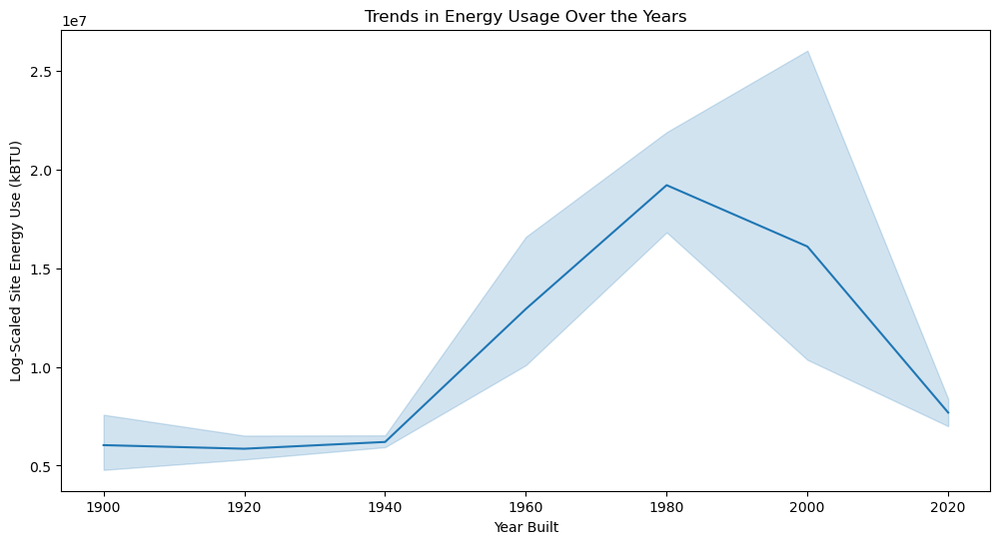

In [54]:
#Visualization 

# Distribution of buildings over the years
plt.figure(figsize=(12, 6))
sns.histplot(df_e['year built'] , bins=30, kde=True)
plt.title('Distribution of Buildings Over the Years')
plt.xlabel('Year Built')
plt.ylabel('Frequency')
plt.show()


# Trends in energy usage over the years
plt.figure(figsize=(12, 6))
#sns.lineplot(x='year built', y='site energy use (kbtu)', data=df_e)
sns.lineplot(x='year built', y='site energy use (kbtu)', data=df_e)
plt.title('Trends in Energy Usage Over the Years')
plt.xlabel('Year Built')
plt.ylabel('Log-Scaled Site Energy Use (kBTU)')
plt.show()

In [55]:
#
df_e['comarea'].value_counts()

comarea
0.0         3923
3000.0        82
1000.0        80
4000.0        76
2000.0        70
            ... 
53856.0        1
185000.0       1
50451.0        1
405.0          1
114287.0       1
Name: count, Length: 3355, dtype: int64

In [56]:
df_e['site energy use (kbtu)'].value_counts()

site energy use (kbtu)
0.0           17
5717602.5      2
10598939.2     2
910888.6       2
5759930.6      2
              ..
3113215.1      1
3170911.2      1
8252308.4      1
221496.8       1
11905190.8     1
Name: count, Length: 8647, dtype: int64

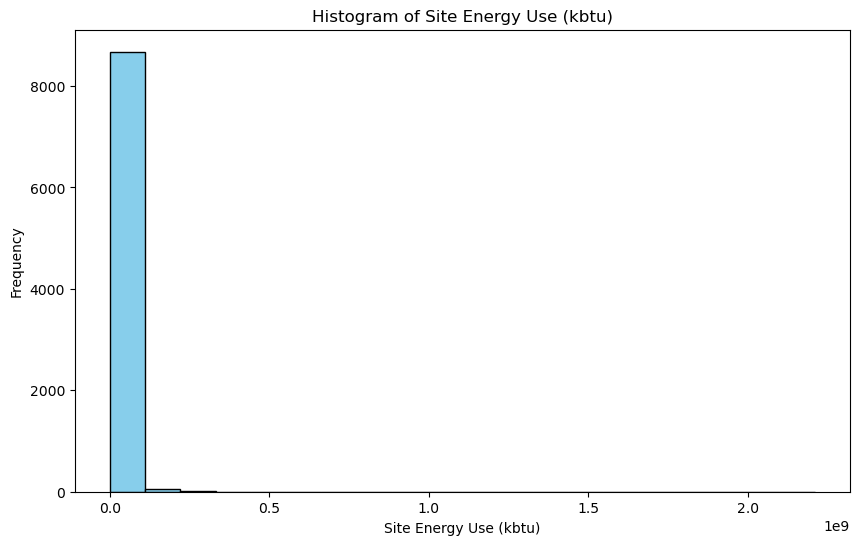

In [57]:

# Plotting histogram for 'site energy use (kbtu)'
plt.figure(figsize=(10, 6))
plt.hist(df_e['site energy use (kbtu)'], bins=20, color='skyblue', edgecolor='black')
plt.title('Histogram of Site Energy Use (kbtu)')
plt.xlabel('Site Energy Use (kbtu)')
plt.ylabel('Frequency')
plt.show()

In [58]:
# Create a list of numerical column names
num = df_e.select_dtypes(include=['float64', 'int64']).columns.tolist()


print("Numerical columns:", num)
#print("Categorical columns:", cat)

Numerical columns: ['lotarea', 'bldgarea', 'numfloors', 'unitstotal', 'assessland', 'largest property use type - gross floor area (ft²)', 'year built', 'number of buildings', 'occupancy', 'property gfa - self-reported (ft²)', 'postal code', 'landuse', 'comarea', 'resarea', 'bldgdepth', 'lottype', 'bsmtcode', 'builtfar', 'residfar', 'commfar', 'facilfar', 'site energy use (kbtu)']


In [59]:
# Create a list of numerical column names
num = df_e.select_dtypes(include=['float64', 'int64']).columns.tolist()

num_exception = [ 'unitstotal','year built', 'number of buildings','occupancy', 'unitsres',
                'bldgdepth','lottype','bsmtcode','landuse']


# Update num and cat list by removing exceptions
num_up = [column for column in num if column not in num_exception]

num_up

['lotarea',
 'bldgarea',
 'numfloors',
 'assessland',
 'largest property use type - gross floor area (ft²)',
 'property gfa - self-reported (ft²)',
 'postal code',
 'comarea',
 'resarea',
 'builtfar',
 'residfar',
 'commfar',
 'facilfar',
 'site energy use (kbtu)']

In [60]:
#these column have been investigated and make more sens to be considered as object base on their meannings
columns_to_convert = ['landuse', 'lottype', 'bsmtcode', 'postal code','year built', 'construction status']

# Convert selected columns to object data type
df_e[columns_to_convert] = df_e[columns_to_convert].astype('object')

In [61]:
df_e.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8738 entries, 0 to 9721
Data columns (total 23 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   lotarea                                             8738 non-null   float64
 1   bldgarea                                            8738 non-null   float64
 2   numfloors                                           8738 non-null   float64
 3   unitstotal                                          8738 non-null   float64
 4   assessland                                          8738 non-null   float64
 5   largest property use type - gross floor area (ft²)  8738 non-null   float64
 6   year built                                          8738 non-null   object 
 7   construction status                                 8738 non-null   object 
 8   number of buildings                                 8738 non-null   int64  
 9   oc

In [62]:
#sanity check 
df_e.shape

(8738, 23)

# Data Transformation: 
As we can see in our data exploration above, we can clearly notice that a lot of features data is highly skewed. 
We will proceed by using the log transformation and the square root method to address this issue. " The square root, x to x^(1/2) = sqrt(x), is a transformation with a moderate effect on distribution shape: it is weaker than the logarithm and the cube root. It is also used for reducing right skewness, and also has the advantage that it can be applied to zero values"."The log transformation is, arguably, the most popular among the different types of transformations used to transform skewed data to approximately conform to normality". from : Boston College, Transformations: an introduction URL: http://fmwww.bc.edu/repec/bocode/t/transint.html#:~:text=The%20square%20root%2C%20x%20to,be%20applied%20to%20zero%20values.  Log-transformation and its implications for data analysis,Changyong FENG,1,*,* Hongyue WANG,1 Naiji LU,1 Tian CHEN,1 Hua HE,1 Ying LU,2 and Xin M. TU1,  Shanghai Arch Psychiatry. 2014 Apr; 26(2): 105–109.
doi: 10.3969/j.issn.1002-0829.2014.02.009

In [63]:
# Create copies of df_e for logarithmic and square root transformations
df_e_lt = df_e.copy()
df_e_srt = df_e.copy()

In [64]:
# Handle NaN values by replacing them with a constant value
df_e_lt.fillna(0, inplace=True)

# Handle negative values by adding a constant to make them positive
df_e_lt[num_up] = df_e_lt[num_up].apply(lambda x: x + abs(x.min()) + 1 if x.min() < 0 else x)



In [65]:
for col in num_up:
    # Add a small positive value to handle zeros and negatives
    df_e_lt[col] = df_e_lt[col].apply(lambda x: x if x > 0 else 0.0001)
    # Apply logarithmic transformation
    df_e_lt[col + '_log'] = np.log(df_e_lt[col] + 1)

# Drop the original columns that were transformed
df_e_lt.drop(columns=num_up, inplace=True)

In [66]:
# Apply square root transformation and create new columns
for col in num_up:
    # Handle negative values by taking the absolute value
    df_e_srt[col] = df_e_srt[col].apply(lambda x: abs(x))
    # Apply square root transformation
    df_e_srt[col + '_sqrt'] = np.sqrt(df_e_srt[col])

# Drop the original columns that were transformed
df_e_srt.drop(columns=num_up, inplace=True)

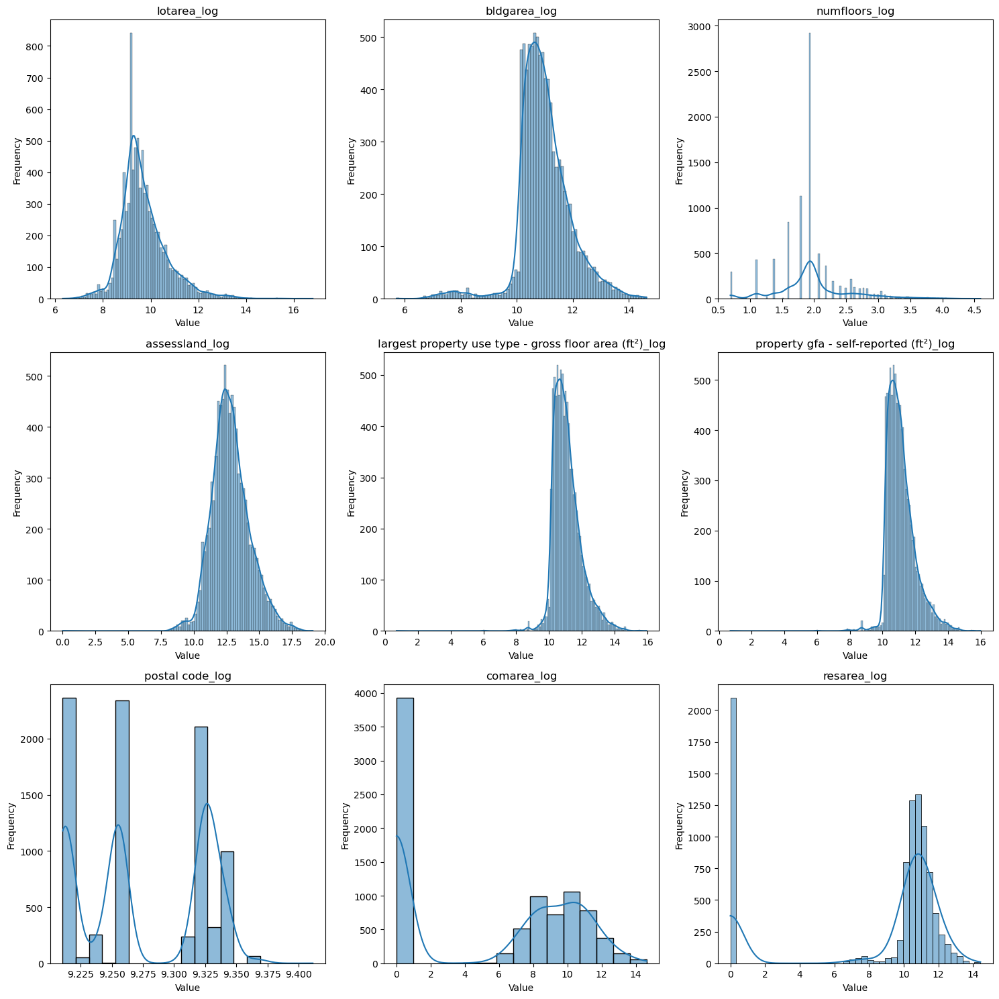

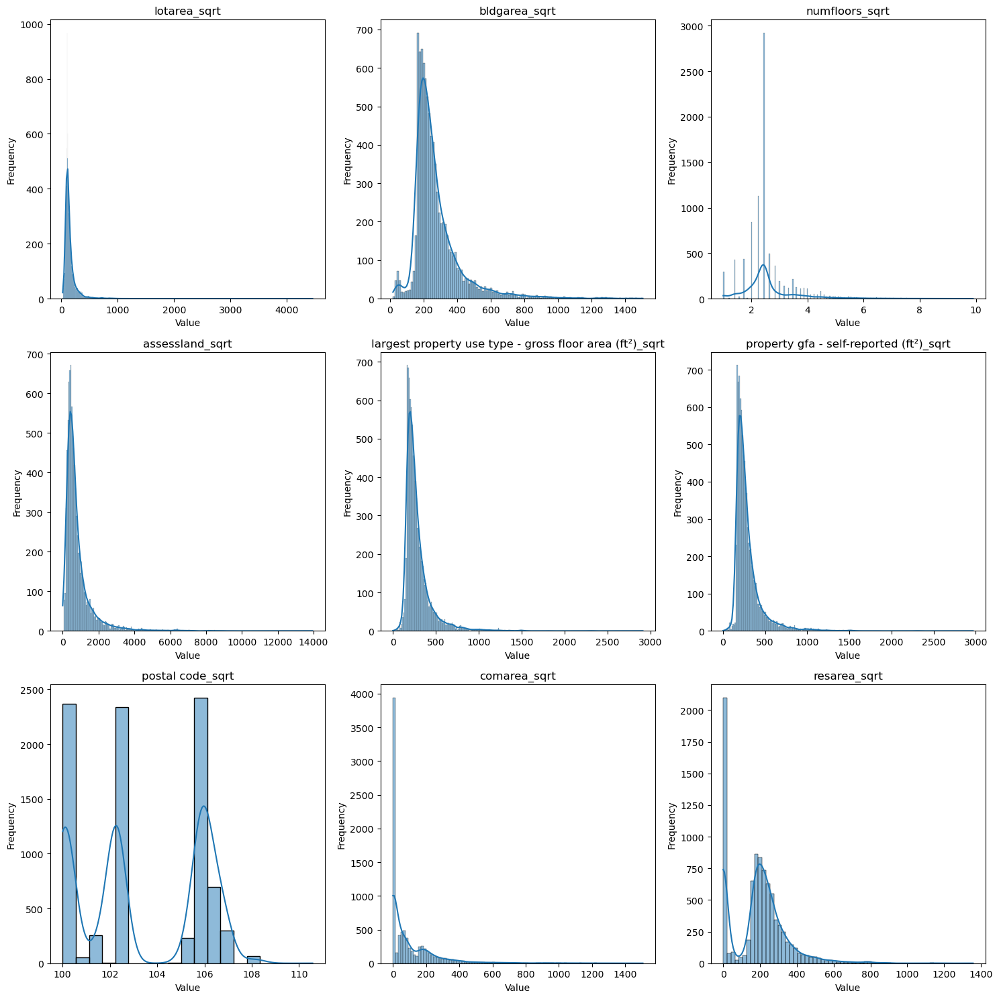

In [67]:
# Function to create 3x3 grid of histograms for columns ending with a specific suffix
def plot_transformed_columns_3x3(df, suffix):
    fig, axes = plt.subplots(3, 3, figsize=(15, 15))
    axes = axes.flatten()  # Flatten the 3x3 matrix of axes

    # Filter columns that end with the specified suffix
    columns_to_plot = [col for col in df.columns if col.endswith(suffix)]

    # Adjust the number of plots based on the number of columns
    num_plots = min(len(columns_to_plot), 9)

    for i in range(num_plots):
        col = columns_to_plot[i]
        sns.histplot(df[col], ax=axes[i], kde=True)
        axes[i].set_title(f'{col}')
        axes[i].set_xlabel('Value')
        axes[i].set_ylabel('Frequency')

    # Hide any empty subplots
    for j in range(num_plots, 9):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.show()

# Visualize the columns ending with '_log' in df_e_lt
plot_transformed_columns_3x3(df_e_lt, '_log')

plot_transformed_columns_3x3(df_e_srt, '_sqrt')

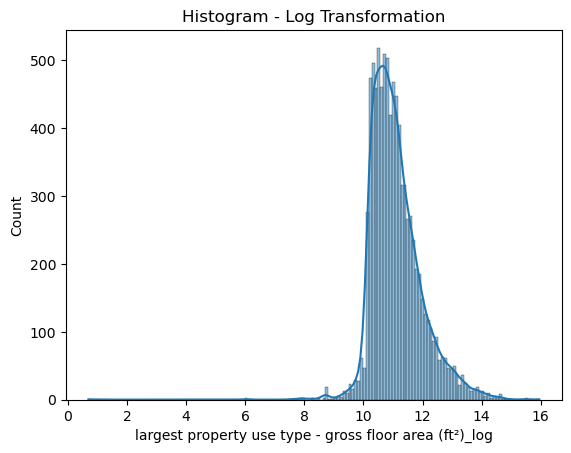

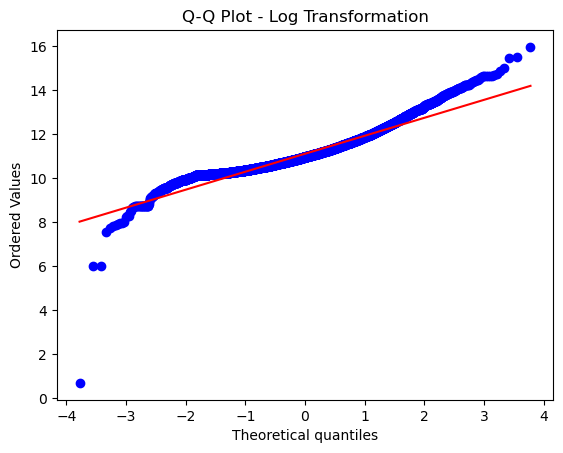

In [68]:
#visualizing the distribution 

import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns


# Function to create a Q-Q plot
def qq_plot(data, title):
    stats.probplot(data, dist="norm", plot=plt)
    plt.title(title)
    plt.show()

# selecting column
column = 'largest property use type - gross floor area (ft²)_log'


# Histogram and Q-Q plot for Log Transformation
sns.histplot(df_e_lt[column], kde=True)
plt.title('Histogram - Log Transformation')
plt.show()

qq_plot(df_e_lt[column], 'Q-Q Plot - Log Transformation')



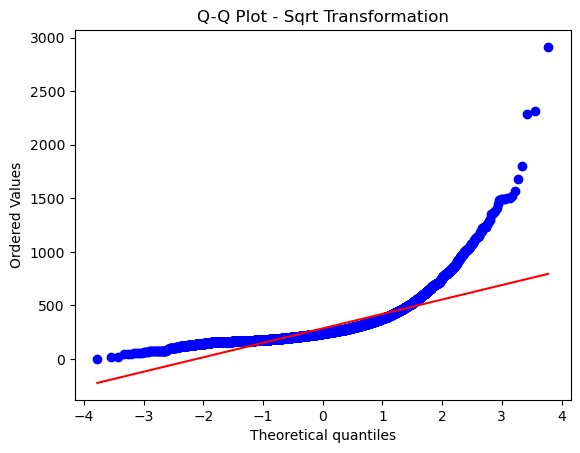

In [69]:
column = 'largest property use type - gross floor area (ft²)_sqrt'
qq_plot(df_e_srt[column], 'Q-Q Plot - Sqrt Transformation')

Summary:  
Upon comparing two types of transformations, the QQ Plot—a graphical tool used to assess the normality of a distribution—indicates a more favorable outcome with the log transformation. Consequently, the subsequent analysis will proceed with the log transformation for enhanced interpretability and improved model performance.

Understanding QQ Plots: URL https://library.virginia.edu/data/articles/understanding-q-q-plots#:~:text=A%20QQ%20plot%20is%20a,truly%20come%20from%20normal%20distributions.

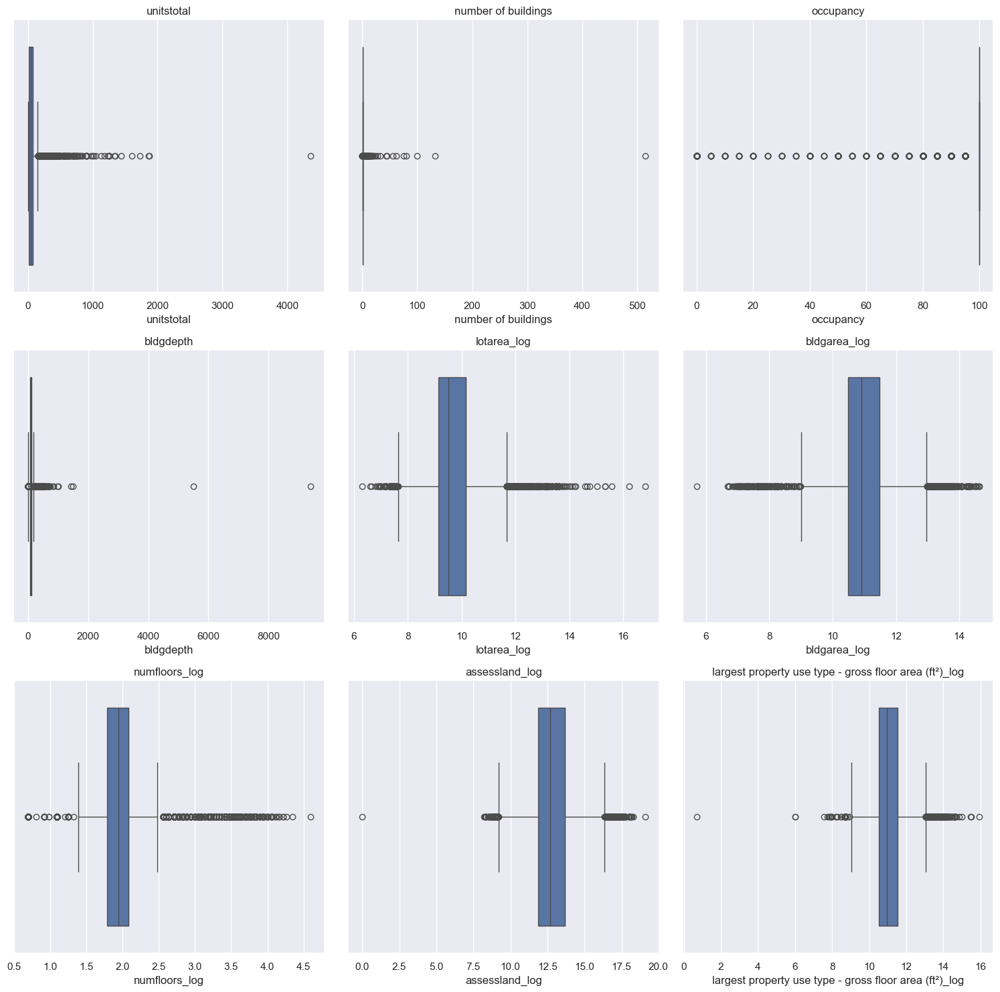

In [70]:

# Set the aesthetic style of the plots
sns.set()

# Select only numerical columns for plotting
numerical_columns = df_e_lt.select_dtypes(include=[np.number]).columns

# Create a 3x3 grid of subplots
fig, axes = plt.subplots(3, 3, figsize=(15, 15))
axes = axes.flatten()  # Flatten the 3x3 matrix of axes

# Plot boxplots in the grid
for i, col in enumerate(numerical_columns):
    if i < 9:  # Ensure we don't go beyond 9 plots
        sns.boxplot(x=df_e_lt[col], ax=axes[i])
        axes[i].set_title(col)
    else:
        break  

# Hide any unused subplots
for j in range(i, 9):
    axes[j].set_visible(False)

plt.tight_layout()
plt.show()

In [71]:
#sns.pairplot(df_e_lt)

In [72]:
df_e.describe()

,lotarea,bldgarea,numfloors,unitstotal,assessland,largest property use type - gross floor area (ft²),number of buildings,occupancy,property gfa - self-reported (ft²),comarea,resarea,bldgdepth,builtfar,residfar,commfar,facilfar,site energy use (kbtu)
count,8.738000e+03,8.738000e+03,8738.000000,8738.000000,8.738000e+03,8.738000e+03,8738.00000,8738.000000,8.738000e+03,8.738000e+03,8.738000e+03,8738.000000,8738.000000,8738.000000,8738.000000,8738.000000,8.738000e+03
mean,3.817679e+04,9.715728e+04,7.621386,65.515908,1.352057e+06,1.076124e+05,1.24445,96.905470,1.120252e+05,3.571263e+04,5.936285e+04,111.181813,4.867122,3.706148,1.403696,5.036049,9.239289e+06
std,2.758983e+05,1.519065e+05,6.845649,111.679230,4.765581e+06,2.121247e+05,6.05809,12.303504,2.222246e+05,1.249375e+05,9.258160e+04,135.709705,4.328597,2.758214,3.300537,2.879559,3.571359e+07
min,5.490000e+02,3.000000e+02,1.000000,0.000000,0.000000e+00,1.000000e+00,0.00000,0.000000,1.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
25%,9.375000e+03,3.556725e+04,5.000000,17.000000,1.450155e+05,3.677175e+04,1.00000,100.000000,3.775800e+04,0.000000e+00,1.877000e+03,80.000000,2.820000,2.430000,0.000000,3.000000,2.742663e+06
50%,1.360150e+04,5.423450e+04,6.000000,45.000000,3.280480e+05,5.736400e+04,1.00000,100.000000,5.851450e+04,1.649000e+03,3.913650e+04,95.000000,4.000000,3.440000,0.000000,4.800000,4.573864e+06
75%,2.566875e+04,9.640975e+04,7.000000,72.000000,8.688375e+05,1.010370e+05,1.00000,100.000000,1.036585e+05,2.552000e+04,6.949625e+04,126.330000,5.080000,5.000000,0.000000,6.500000,7.731794e+06
max,1.985040e+07,2.267925e+06,98.000000,4356.000000,1.944014e+08,8.481114e+06,514.00000,100.000000,8.811722e+06,2.267925e+06,1.841504e+06,9388.000000,88.550000,10.000000,15.000000,15.000000,2.208957e+09


In [73]:
#sns.pairplot(df_e_lt_numeric)

In [74]:
#selecting columns to plot
columns_to_plot = [
    'lotarea_log',
    'bldgarea_log',  
    'assessland_log',
    'site energy use (kbtu)_log','largest property use type - gross floor area (ft²)_log',
     'property gfa - self-reported (ft²)_log'
    
    
]

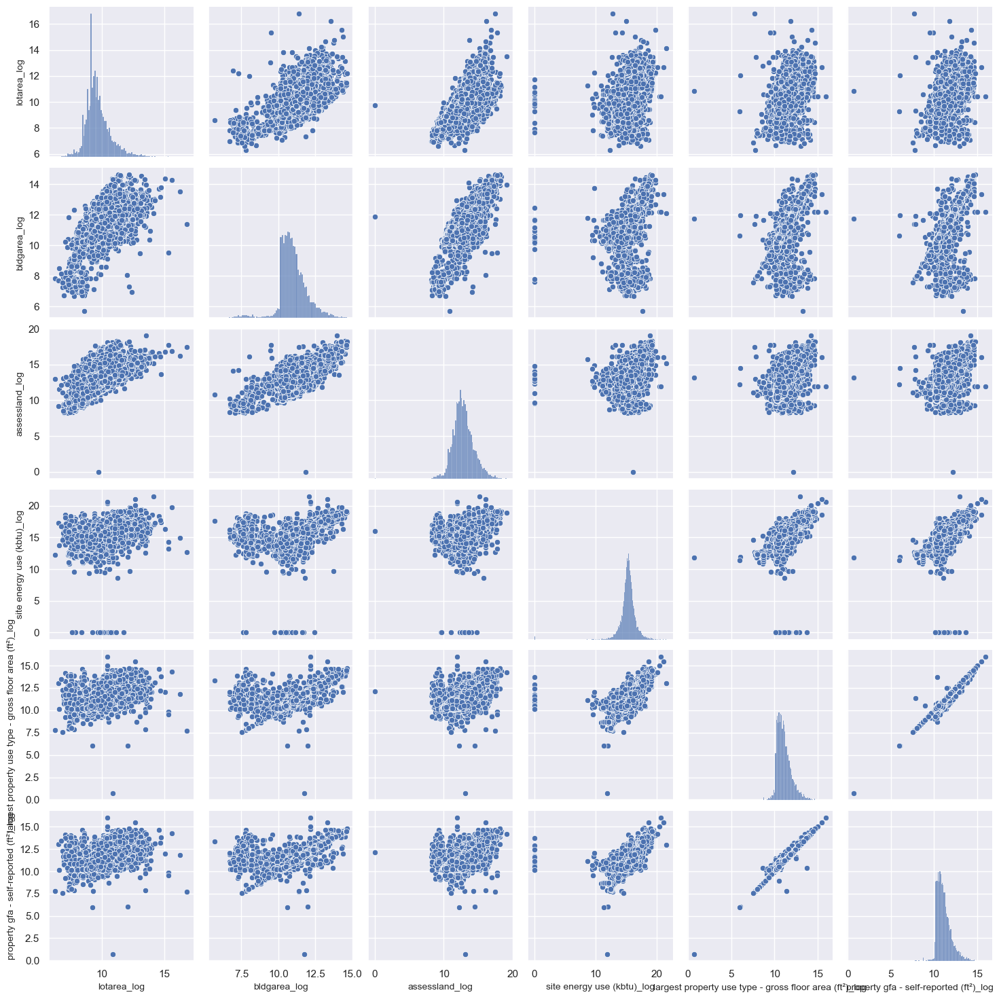

In [75]:
import seaborn as sns


# Create a pairplot and assign it to pair_plot
plot = sns.pairplot(df_e_lt[columns_to_plot])

# Adjust label sizes in the pairplot
for ax in plot.axes.flatten():
    # Adjust x-axis label font size
    ax.set_xlabel(ax.get_xlabel(), fontsize = 10)
    # Adjust y-axis label font size
    ax.set_ylabel(ax.get_ylabel(), fontsize = 10)

plt.show()

In [76]:
#Analysing the relationship between different numerical variables in df_e
df_e_lt_numeric = df_e_lt.select_dtypes(include=['float64', 'int64'])
df_e_lt_numeric.corr()

,unitstotal,number of buildings,occupancy,bldgdepth,lotarea_log,bldgarea_log,numfloors_log,assessland_log,largest property use type - gross floor area (ft²)_log,property gfa - self-reported (ft²)_log,postal code_log,comarea_log,resarea_log,builtfar_log,residfar_log,commfar_log,facilfar_log,site energy use (kbtu)_log
unitstotal,1.000000,0.054700,0.051500,0.030378,0.281961,0.449548,0.402938,0.260032,0.455331,0.449396,-0.011216,-0.046832,0.340990,0.183551,0.138194,0.001345,0.109572,0.328533
number of buildings,0.054700,1.000000,0.003800,-0.004077,0.093094,0.039378,-0.034435,0.035735,0.074816,0.073791,0.027118,-0.024944,0.022899,-0.060760,-0.040086,-0.016737,-0.049071,0.052171
occupancy,0.051500,0.003800,1.000000,-0.016441,-0.000111,-0.000611,0.019297,-0.100981,-0.017306,-0.024622,0.024162,-0.168897,0.210801,-0.018791,0.023116,-0.169885,-0.026927,0.207239
bldgdepth,0.030378,-0.004077,-0.016441,1.000000,0.239190,0.193120,-0.038175,0.176989,0.156459,0.157256,0.026496,0.132686,-0.131476,-0.057021,-0.068793,0.062761,-0.028746,0.099198
lotarea_log,0.281961,0.093094,-0.000111,0.239190,1.000000,0.641642,-0.099520,0.501099,0.497534,0.497353,0.237390,0.236972,-0.207843,-0.417845,-0.326852,-0.064044,-0.311373,0.340497
bldgarea_log,0.449548,0.039378,-0.000611,0.193120,0.641642,1.000000,0.564873,0.686090,0.722882,0.721944,-0.039094,0.264766,0.031853,0.404356,0.181163,0.207157,0.235267,0.500248
numfloors_log,0.402938,-0.034435,0.019297,-0.038175,-0.099520,0.564873,1.000000,0.425550,0.505030,0.502683,-0.318401,0.052599,0.322049,0.807604,0.546761,0.299970,0.543413,0.368445
assessland_log,0.260032,0.035735,-0.100981,0.176989,0.501099,0.686090,0.425550,1.000000,0.538061,0.555794,-0.137928,0.486178,-0.276781,0.274891,0.138370,0.456752,0.214719,0.345114
largest property use type - gross floor area (ft²)_log,0.455331,0.074816,-0.017306,0.156459,0.497534,0.722882,0.505030,0.538061,1.000000,0.988683,-0.127744,0.201215,0.025563,0.284992,0.124524,0.197721,0.159681,0.643843
property gfa - self-reported (ft²)_log,0.449396,0.073791,-0.024622,0.157256,0.497353,0.721944,0.502683,0.555794,0.988683,1.000000,-0.134911,0.235968,0.002601,0.286654,0.119613,0.225034,0.163883,0.650931


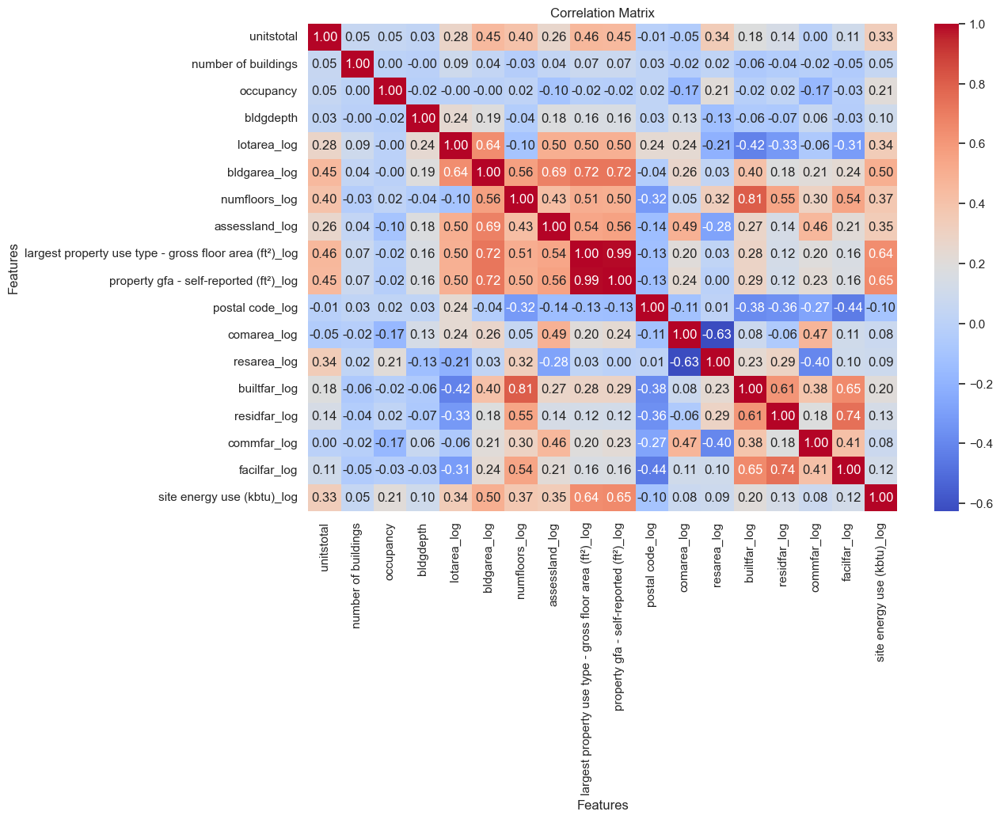

In [77]:
## Visualization with Heatmap

# Set the size of the figure
plt.figure(figsize=(12, 8))

corr_matrix = df_e_lt_numeric.corr()
# Draw the heatmap
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)

# Adding titles and labels.
plt.title('Correlation Matrix')
plt.xlabel('Features')
plt.ylabel('Features')

# Show the plot
plt.show()


## Meaningful Zeros

In our dataset, the concept of meaningful zeros plays a crucial role in understanding various Features. Meaningful zeros refer to instances where a data point or feature holds a value of zero, and this zero has significant implications for the interpretation of the data. For example, in the 'unitsres' column, a value of zero indicates that there are no residential units in the tax lot, providing valuable information about the absence of housing in those instances. Similarly, in the 'occupancy' column, a zero signifies that a certain percentage of Gross Floor Area (GFA) is unoccupied and non-operational, shedding light on the vacant areas. The 'easements' column, with a meaningful zero, suggests that a tax lot has no easements. Additionally, in the 'resarea' column, a zero value implies the absence of common residential areas in the building. Recognizing and analyzing these meaningful zeros enhance our understanding of the dataset, allowing for more accurate interpretations and informed decision-making in subsequent analyses.

In [78]:
#choosing the non zero values
df_e_lt= df_e_lt[df_e_lt['site energy use (kbtu)_log']!= 0]


In [79]:
#value counts 
for column in df_e_lt.columns:
    print(f"=== Value Counts for {column} ===")
    print(df_e_lt[column].value_counts())
    print("\n")


=== Value Counts for unitstotal ===
unitstotal
1.0      1070
2.0       271
60.0      178
48.0      161
42.0      151
         ... 
498.0       1
506.0       1
223.0       1
396.0       1
550.0       1
Name: count, Length: 453, dtype: int64


=== Value Counts for year built ===
year built
1940    3335
2020    1384
1960    1183
1920    1139
1980     907
2000     520
1900     270
Name: count, dtype: int64


=== Value Counts for construction status ===
construction status
existing    8734
test           3
design         1
Name: count, dtype: int64


=== Value Counts for number of buildings ===
number of buildings
1      8408
2       141
3        61
4        32
5        15
6        13
12        9
0         9
8         7
7         6
10        6
11        4
13        4
9         3
19        2
80        1
45        1
32        1
132       1
75        1
62        1
16        1
56        1
14        1
15        1
24        1
17        1
22        1
18        1
28        1
99        1
514       1

In [80]:
#Removing outliers
# Loop through each numeric column and remove outliers
for col in df_e_lt_numeric:
    mean_value = df_e_lt[col].mean()
    std_dev_value = df_e_lt[col].std()
    
    # lets define 3 standard deviations as theresold
    threshold = 3
    
    # Identify outliers in the current column
    outliers = ((df_e_lt[col] - mean_value).abs() > threshold * std_dev_value)
    
    # Remove outliers from the current column
    df_e_lt[col] = np.where(outliers, np.nan, df_e_lt[col]);

In [81]:
df_e_lt = df_e_lt.dropna()

In [82]:
df_e_lt.shape

(7862, 23)

In [83]:
# Splitting the data
target_energy_efficiency = 'site energy use (kbtu)_log'

#X_e = df_e_c_dropped.select_dtypes(exclude=['object'])
X = df_e_lt.drop('site energy use (kbtu)_log',axis=1)

y = df_e_lt[target_energy_efficiency]

y.shape, X.shape

((7862,), (7862, 22))

In [84]:
#Performing train test split
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=.25, random_state=42)

In [85]:
print(X_train.columns)


Index(['unitstotal', 'year built', 'construction status',
       'number of buildings', 'occupancy', 'landuse', 'bldgdepth', 'lottype',
       'bsmtcode', 'lotarea_log', 'bldgarea_log', 'numfloors_log',
       'assessland_log',
       'largest property use type - gross floor area (ft²)_log',
       'property gfa - self-reported (ft²)_log', 'postal code_log',
       'comarea_log', 'resarea_log', 'builtfar_log', 'residfar_log',
       'commfar_log', 'facilfar_log'],
      dtype='object')


In [86]:
# Create a list of categorical column names
cat = X_train.select_dtypes(include=['object', 'category']).columns.tolist()
cat

['year built', 'construction status', 'landuse', 'lottype', 'bsmtcode']

In [87]:
cat = X_train.select_dtypes(include=['object', 'category']).columns.tolist()
cat_exception = ['unitsres'] #postal code
cat_up = [col for col in cat if col not in cat_exception]
cat_up 

['year built', 'construction status', 'landuse', 'lottype', 'bsmtcode']

In [88]:
# Instantiate transformer
ohe = OneHotEncoder(drop='first', sparse=False,handle_unknown='ignore')

In [89]:
# Transform the categorical columns
X_train_encoded = ohe.fit_transform(X_train[cat_up])
X_test_encoded = ohe.transform(X_test[cat_up])

# Convert the transformed array back into a DataFrame
X_train_encoded_df = pd.DataFrame(X_train_encoded, 
                                  columns=ohe.get_feature_names_out(cat_up), 
                                  index=X_train.index)

# Drop the original categorical columns from X_train
X_train.drop(columns=cat_up, inplace=True)

# Concatenate the remaining columns of X_train with the new one-hot encoded columns
X_train = pd.concat([X_train, X_train_encoded_df], axis=1)

# Convert any remaining non-numeric columns to numeric types
X_train = X_train.apply(pd.to_numeric, errors='coerce')



/Users/DonJuve/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/Users/DonJuve/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [90]:
# Transform the categorical columns in X_test using the already fitted ohe
X_test_encoded = ohe.transform(X_test[cat_up])

# Convert the transformed array back into a DataFrame
X_test_encoded_df = pd.DataFrame(X_test_encoded, 
                                 columns=ohe.get_feature_names_out(cat_up), 
                                 index=X_test.index)

# Drop the original categorical columns from X_test
X_test.drop(columns=cat_up, inplace=True)

# Concatenate the remaining columns of X_test with the new one-hot encoded columns
X_test = pd.concat([X_test, X_test_encoded_df], axis=1)

# Convert any remaining non-numeric columns to numeric types
X_test = X_test.apply(pd.to_numeric, errors='coerce')


/Users/DonJuve/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [91]:
#sanity check 
X_train.shape, y_train.shape

((5896, 44), (5896,))

In [92]:
df_e_lt.shape

(7862, 23)

# Modelling 

Metrics interpretation: 

* Mean Squared Error (MSE): This metric measures the average squared difference between the actual and predicted values of the target variable. In this case, it assesses the accuracy of our energy efficiency model.
* R-Squared (R²): R-squared explains the proportion of the variance in the target variable that is explained by the independent variables in the model. It ranges from 0 to 1, with higher values indicating better fit.
* Mean MSE - Cross Validation: This is the average of the mean squared errors obtained from cross-validation. It provides insight into the model's performance across different subsets of the data.
* Cross-validated R-Squared: This metric evaluates the R-squared value obtained through cross-validation, indicating the model's predictive power across various data splits.

In [104]:
# Create a dummy regressor
dummy_regressor = DummyRegressor(strategy='mean')  

# Fit the dummy model
dummy_regressor.fit(X_train, y_train)

# Predict using the dummy model
y_pred_dummy = dummy_regressor.predict(X_train)

# Evaluate the performance
mse_dummy = mean_squared_error(y_train, y_pred_dummy)
accuracy_dummy = cross_val_score(dummy_regressor, X_train, y_train).mean()
rmse_dummy = np.sqrt(mse_dummy)  

print("=== Dummy Regressor MODEL SUMMARY==")
print("Mean Squared Error for Dummy Regressor:", mse_dummy)
print("Root Mean Squared Error for Dummy Regressor:", rmse_dummy)
print("Dummy Model Accuracy (cross-validated):", accuracy_dummy)

=== Dummy Regressor MODEL SUMMARY==
Mean Squared Error for Dummy Regressor: 0.7760513028781493
Root Mean Squared Error for Dummy Regressor: 0.8809377406367316
Dummy Model Accuracy (cross-validated): -0.0015236223590759934


## Model with Linear Regression

In [105]:
# Initialize and train the Linear Regression model
lr_model = LinearRegression(n_jobs=150)

lr_model.fit(X_train, y_train)

# Make predictions and evaluate the model 
y_pred_lr = lr_model.predict(X_train)
mse_e_lr = mean_squared_error(y_train, y_pred_lr)

# Evaluate the performance
mse_lr = mean_squared_error(y_train, y_pred_lr)
rmse_lr = np.sqrt(mse_lr)  # Calculate Root Mean Squared Error
mse_scores_lr = -(cross_val_score(lr_model, X_train, y_train, cv=3, scoring='neg_mean_squared_error'))
mse_scores_lr_mean = mse_scores_lr.mean()
rsquared_lr = lr_model.score(X_train, y_train)
accuracy_lr = cross_val_score(lr_model, X_train, y_train).mean()

print("=== Linear Regression MODEL SUMMARY==")
print("Mean Squared Error for Energy Efficiency model:", mse_lr)
print("Root Mean Squared Error for Energy Efficiency model:", rmse_lr)
print("R-Squared:", rsquared_lr)  # explain variation in the target
print("Mean MSE - cross val:", mse_scores_lr_mean)
print("Cross-validate R-Squared:", accuracy_lr)

=== Linear Regression MODEL SUMMARY==
Mean Squared Error for Energy Efficiency model: 0.29749986278976687
Root Mean Squared Error for Energy Efficiency model: 0.5454354799513568
R-Squared: 0.6166492322267534
Mean MSE - cross val: 0.3060069553629476
Cross-validate R-Squared: 0.6063433752429618


* Summary: 

Mean Squared Error (MSE) for Energy Efficiency model: 0.2975
Root Mean Squared Error (RMSE) for Energy Efficiency model: 0.5454
R-Squared (R2): 0.6166 indicate how well the model explains the variation in the target variable. In this case, the model explains approximately 61.66% of the variability in the target.
Mean MSE - Cross-validation: 0.3060 indicating the model's performance on different subsets of the data.
Cross-validate R-Squared: 0.6063 is the average R-squared obtained through cross-validation, providing an overall assessment of the model's performance on different data folds.
Overall, the model seems to perform reasonably well, with a moderate R-squared value indicating a good level of explained variability in the target. The RMSE provides a measure of the average prediction error, and the cross-validation metrics give an indication of the model's generalization performance.

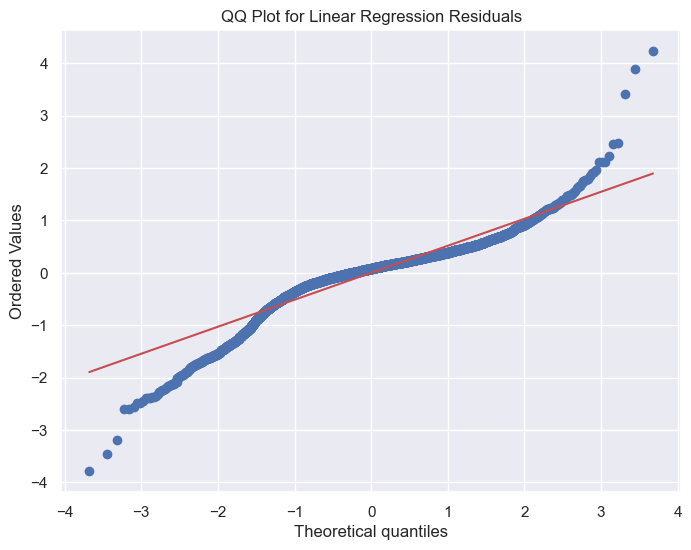

In [95]:
# Residuals calculation
residuals = y_train - y_pred_lr

# QQ plot
fig, ax = plt.subplots(figsize=(8, 6))
stats.probplot(residuals, dist="norm", plot=plt)
plt.title('QQ Plot for Linear Regression Residuals')
plt.show()

## Model with Random Forest Regressor

In [106]:

# Initialize the Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=150,max_depth=None, max_features='sqrt', min_samples_leaf=1, min_samples_split=6,random_state=42)#n_estimators=150,max_depth=None, max_features='sqrt', min_samples_leaf=1, min_samples_split=6,random_state=42
#{'max_depth': 100, 'max_features': 0.5, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 150}
#Fitting the model 
rf_model.fit(X_train, y_train)

#calculate y_pred_rf on train

y_pred_train_rf = rf_model.predict(X_train)
mse_e_rf = mean_squared_error(y_train, y_pred_train_rf)

# Evaluate the performance
mse_e_rf = mean_squared_error(y_train, y_pred_train_rf)
rmse_e_rf = np.sqrt(mse_e_rf)  # Calculate Root Mean Squared Error
mse_scores_rf = -(cross_val_score(rf_model, X_train, y_train, cv=5, scoring='neg_mean_squared_error'))
mse_scores_rf_mean = mse_scores_rf.mean()
rsquared_rf = r2_score(y_train, y_pred_train_rf)
accuracy_rf = cross_val_score(rf_model, X_train, y_train).mean()
y_pred_cv_rf = cross_val_predict(rf_model, X_train, y_train, cv=5)

print("=== Random Forest Regressor MODEL SUMMARY==")
print("Mean Squared Error for RF model:", mse_e_rf)
print("Root Mean Squared Error for RF model:", rmse_e_rf)
print("R-Squared:", rsquared_rf)  # Explain variation in the target
print("Mean MSE - cross val:", mse_scores_rf_mean)
print("Cross-validate R-Squared:", accuracy_rf)
'''
Result with 0 tunning parameters
===Random Forest Regressor MODEL SUMMARY==
Mean Squared Error for RF model: 0.043189197222143975
R-Squared 0.6166492322267534
Mean MSE:-cross val  0.30431118211743263
Cross validate R-Squared 0.6063675561682402


#n_estimators=150,max_depth=None, max_features='sqrt', min_samples_leaf=1, min_samples_split=6,random_state=42
===Random Forest Regressor MODEL SUMMARY==
Mean Squared Error for RF model: 0.0879209018990786
R-Squared 0.6166492322267534
Mean MSE:-cross val  0.2973169906036435
Cross validate R-Squared 0.6151865163137223


(n_estimators=150,max_depth=150, max_features=0.5, min_samples_leaf=1, min_samples_split=10,random_state=42)
===Random Forest Regressor MODEL SUMMARY==
Mean Squared Error for RF model: 0.09798290659472157
R-Squared 0.6166492322267534
Mean MSE:-cross val  0.29862718685119227
Cross validate R-Squared 0.6136205749898387

'''

=== Random Forest Regressor MODEL SUMMARY==
Mean Squared Error for RF model: 0.0879209018990786
Root Mean Squared Error for RF model: 0.29651458969008354
R-Squared: 0.886707358684915
Mean MSE - cross val: 0.2973169906036435
Cross-validate R-Squared: 0.6151865163137223


"\nResult with 0 tunning parameters\n===Random Forest Regressor MODEL SUMMARY==\nMean Squared Error for RF model: 0.043189197222143975\nR-Squared 0.6166492322267534\nMean MSE:-cross val  0.30431118211743263\nCross validate R-Squared 0.6063675561682402\n\n\n#n_estimators=150,max_depth=None, max_features='sqrt', min_samples_leaf=1, min_samples_split=6,random_state=42\n===Random Forest Regressor MODEL SUMMARY==\nMean Squared Error for RF model: 0.0879209018990786\nR-Squared 0.6166492322267534\nMean MSE:-cross val  0.2973169906036435\nCross validate R-Squared 0.6151865163137223\n\n\n(n_estimators=150,max_depth=150, max_features=0.5, min_samples_leaf=1, min_samples_split=10,random_state=42)\n===Random Forest Regressor MODEL SUMMARY==\nMean Squared Error for RF model: 0.09798290659472157\nR-Squared 0.6166492322267534\nMean MSE:-cross val  0.29862718685119227\nCross validate R-Squared 0.6136205749898387\n\n"

* Summary : 

Mean Squared Error (MSE) for RF model: 0.0879
Root Mean Squared Error (RMSE) for RF model: 0.2965
R-Squared (R²): 0.8867 is a measure of how well the model explains the variation in the target variable. In this case, the model explains approximately 88.67% of the variability in the target.
Mean MSE - Cross-validation: 0.2973 is indicating the model's performance on different subsets of the data.
Cross-validate R-Squared: 0.6152 is providing an overall assessment of the model's performance on different data folds.


In [97]:
# Get feature names
feature_names = X_train.columns

# Get feature importances
importances = rf_model.feature_importances_

# Create a DataFrame from the features and their importances
feature_importance = pd.DataFrame({'Feature': feature_names, 'Importance': importances})

# Sort features by their importance
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)

# print the feature data set
feature_importance


,Feature,Importance
8,largest property use type - gross floor area (...,1.761419e-01
9,property gfa - self-reported (ft²)_log,1.744395e-01
5,bldgarea_log,1.166557e-01
0,unitstotal,7.467063e-02
12,resarea_log,7.365405e-02
4,lotarea_log,5.311640e-02
7,assessland_log,5.227818e-02
11,comarea_log,3.527486e-02
13,builtfar_log,3.413939e-02
6,numfloors_log,3.010782e-02


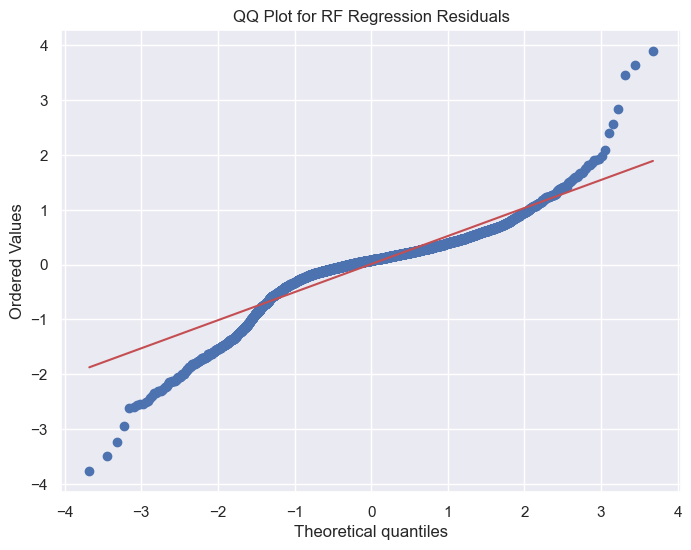

In [98]:
# Calculate residuals
residuals = y_train - y_pred_cv_rf

# QQ plot
fig, ax = plt.subplots(figsize=(8, 6))
stats.probplot(residuals, dist="norm", plot=plt)
plt.title('QQ Plot for RF Regression Residuals')
plt.show()

In [108]:
##### Using Grid search to look for the best parameters

param_grid = {
   'max_depth': [None, 100, 150],
   'min_samples_leaf': [1,5,10],
   'min_samples_split':[6, 8, 10],
   'n_estimators':[100,150,200],
   'max_features':['auto','sqrt', 'log2', 0.5,None ]
}

rf_model = RandomForestRegressor()

grid_search = GridSearchCV(rf_model, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

#Best parameters
print("Best parameters found: ", grid_search.best_params_)

#Best cross-validated score
print("Best cross-validated accuracy: {:.2f}".format(grid_search.best_score_))

/Users/DonJuve/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:425: FitFailedWarning: 
405 fits failed out of a total of 2025.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
405 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/DonJuve/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 732, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/DonJuve/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/base.py", line 1144, in wrapper
    estimator._validate_params()
  File "/Users/DonJuve/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/base.py", line 637, in 

Best parameters found:  {'max_depth': 100, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 8, 'n_estimators': 200}
Best cross-validated accuracy: -0.30


for more gridsearch please see part # in the draft notebook Part 5 URL : https://github.com/juved/Predicting-Energy-consumption-in-NYC/blob/main/draft_project_notebook.ipynb

## Model with Gradient Descent XGboost

In [109]:
#pip install xgboost

In [99]:
#lets reset X_train
X_train = X_train.reset_index(drop=True)
X_train

,unitstotal,number of buildings,occupancy,bldgdepth,lotarea_log,bldgarea_log,numfloors_log,assessland_log,largest property use type - gross floor area (ft²)_log,property gfa - self-reported (ft²)_log,...,lottype_2.0,lottype_3.0,lottype_4.0,lottype_5.0,lottype_6.0,lottype_7.0,lottype_9.0,bsmtcode_1.0,bsmtcode_2.0,bsmtcode_5.0
0,78.0,1.0,100.0,100.00,9.615872,11.081573,1.945910,12.729324,10.933660,10.986597,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,63.0,1.0,100.0,110.00,9.330432,10.818397,1.945910,12.626922,10.818397,10.818397,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,19.0,1.0,100.0,0.00,9.024854,10.012297,2.079442,11.952831,10.211230,10.211230,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,1.0,1.0,100.0,350.00,11.289794,11.156265,0.693147,13.381648,11.214533,11.214533,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,99.0,1.0,80.0,47.67,10.169959,11.387260,2.397895,12.923793,11.387260,11.387260,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5891,25.0,1.0,90.0,95.00,9.159152,10.570881,2.564949,12.272567,10.570881,10.570881,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5892,51.0,1.0,100.0,85.00,8.956995,10.517673,1.791759,11.560296,10.441821,10.517673,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
5893,30.0,1.0,100.0,88.00,9.082621,10.203629,1.791759,11.279744,10.203629,10.203629,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
5894,385.0,3.0,100.0,320.00,12.581838,12.773659,1.945910,15.184570,12.773659,12.773659,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [108]:


# Create the XGBoost instance
xgb_model = xgb.XGBRegressor(learning_rate =  0.1,n_estimators =100, max_depth = None, random_state=42) 
# Fit the model
xgb_model.fit(X_train, y_train)


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

In [109]:
#calculate y_pred_xgb on train

y_pred_train_xgb = xgb_model.predict(X_train)

#Cross validation 
mse_scores_xgb = -(cross_val_score(xgb_model, X_train, y_train, cv=3, scoring='neg_mean_squared_error'))
mse_scores_xgb_mean =mse_scores_xgb.mean()

# Evaluate the performance
mse_e_xgb = mean_squared_error(y_train, y_pred_train_xgb)
rmse_e_xgb = np.sqrt(mse_e_xgb)  # Calculate Root Mean Squared Error
mse_scores_xgb = -(cross_val_score(xgb_model, X_train, y_train, cv=3, scoring='neg_mean_squared_error'))
rsquared_xgb = r2_score(y_train, y_pred_train_xgb)
accuracy_xgb = cross_val_score(xgb_model, X_train, y_train).mean()

# Calculate and print metrics on the training set
print("=== Gradient Descent XGBoost MODEL SUMMARY==")
print("Mean Squared Error Training:", mse_e_xgb)
print("Root Mean Squared Error Training:", rmse_e_xgb)
print("R-squared Training:", rsquared_xgb)
print("Mean Squared Error - Cross-validated:", mse_scores_xgb_mean)
print("Model cross-val accuracy:", accuracy_xgb)
'''
* NO parameters tunning: 
=== Gradient Descent XGBoost MODEL SUMMARY==
Mean Squared Error Training: 6.008596471004995
R-squared  Training: 0.8988459668150307
Mean Squared average:/ Crossval 6.008596471004995
Model cross val accuracy 0.04641573928997811

* #n_estimators =100, max_depth = 5, max_features = 'auto', min_samples_leaf =2, min_samples_plit=2, random_state=42

=== Gradient Descent XGBoost MODEL SUMMARY==
Mean Squared Error Training: 5.822487360462616
R-squared  Training: 0.8254569806834353
Mean Squared average:/ Crossval 5.822487360462616
Model cross val accuracy 0.08815031431852563

'max_depth': None, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
Best cross-validated accuracy: -5.91

=== Gradient Descent XGBoost MODEL SUMMARY==
Mean Squared Error Training: 6.008596471004995
R-squared  Training: 0.8988459668150307
Mean Squared average:/ Crossval 6.008596471004995
Model cross val accuracy 0.04641573928997811

ate =  0.1,n_estimators =100, max_depth = None, max_features = 'auto', min_samples_leaf =1, min_samples_plit=2, random_state=42
=== Gradient Descent XGBoost MODEL SUMMARY==
Mean Squared Error Training: 5.291337174728462
R-squared  Training: 0.7217640776329552
Mean Squared average:/ Crossval 5.291337174728462
Model cross val accuracy 0.16401297905964893

removing postal code: 
learning_rate =  0.1,n_estimators =100, max_depth = None, max_features = 'auto', min_samples_leaf =1, min_samples_plit=2, random_state=42
=== Gradient Descent XGBoost MODEL SUMMARY==
Mean Squared Error Training: 5.177568952835252
R-squared  Training: 0.6994935252154137
Mean Squared average:/ Crossval 5.177568952835252
Model cross val accuracy 0.18274854903026444

learning_rate =  0.1,n_estimators =100, max_depth = None, max_features = 'auto', min_samples_leaf =1, min_samples_plit=2, random_state=42
=== Gradient Descent XGBoost MODEL SUMMARY==
Mean Squared Error Training: 0.30602324238418294
R-squared  Training: 0.806318386262455
Mean Squared average:/ Crossval 0.30602324238418294
Model cross val accuracy 0.611263780445625

'''

=== Gradient Descent XGBoost MODEL SUMMARY==
Mean Squared Error Training: 0.15030686868456428
Root Mean Squared Error Training: 0.38769429797788396
R-squared Training: 0.806318386262455
Mean Squared Error - Cross-validated: 0.30602324238418294
Model cross-val accuracy: 0.611263780445625


"\n* NO parameters tunning: \n=== Gradient Descent XGBoost MODEL SUMMARY==\nMean Squared Error Training: 6.008596471004995\nR-squared  Training: 0.8988459668150307\nMean Squared average:/ Crossval 6.008596471004995\nModel cross val accuracy 0.04641573928997811\n\n* #n_estimators =100, max_depth = 5, max_features = 'auto', min_samples_leaf =2, min_samples_plit=2, random_state=42\n\n=== Gradient Descent XGBoost MODEL SUMMARY==\nMean Squared Error Training: 5.822487360462616\nR-squared  Training: 0.8254569806834353\nMean Squared average:/ Crossval 5.822487360462616\nModel cross val accuracy 0.08815031431852563\n\n'max_depth': None, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}\nBest cross-validated accuracy: -5.91\n\n=== Gradient Descent XGBoost MODEL SUMMARY==\nMean Squared Error Training: 6.008596471004995\nR-squared  Training: 0.8988459668150307\nMean Squared average:/ Crossval 6.008596471004995\nModel cross val accuracy 0.04641573928997811

Mean Squared Error (MSE) Training: 0.1503
Root Mean Squared Error (RMSE) Training: 0.3877
R-Squared (R²) Training: 0.8063 explaine how well the model explains the variation in the target variable. 
Mean Squared Error - Cross-validated: 0.3060 indicating the model's performance on different subsets of the data.
Model Cross-validation Accuracy: 0.6113, providing an overall assessment of the model's performance on different data folds.

In [113]:
#Using Grid search to look for the best parameters



param_grid = {
    'learning_rate':[0.01, 0.1, 0.2],
    'max_depth': [None, 20, 50],
    'n_estimators': [100, 120, 140],
    'max_depth': [None, 50, 100],
    'min_child_weight': [1, 5, 10],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0],
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': [100, 150, 200],
}
xgb_model = xgb.XGBRegressor()

grid_search = GridSearchCV(xgb_model, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

#Best parameters
print("Best parameters found: ", grid_search.best_params_)

#Best cross-validated score
print("Best cross-validated accuracy: {:.2f}".format(grid_search.best_score_))

Best parameters found:  {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': None, 'min_child_weight': 5, 'n_estimators': 100, 'subsample': 0.8}
Best cross-validated accuracy: -0.30


More grid search on xgboost see part # in the draft notebook Part 6 : URL https://github.com/juved/Predicting-Energy-consumption-in-NYC/blob/main/draft_project_notebook.ipynb

## Models Evaluation 

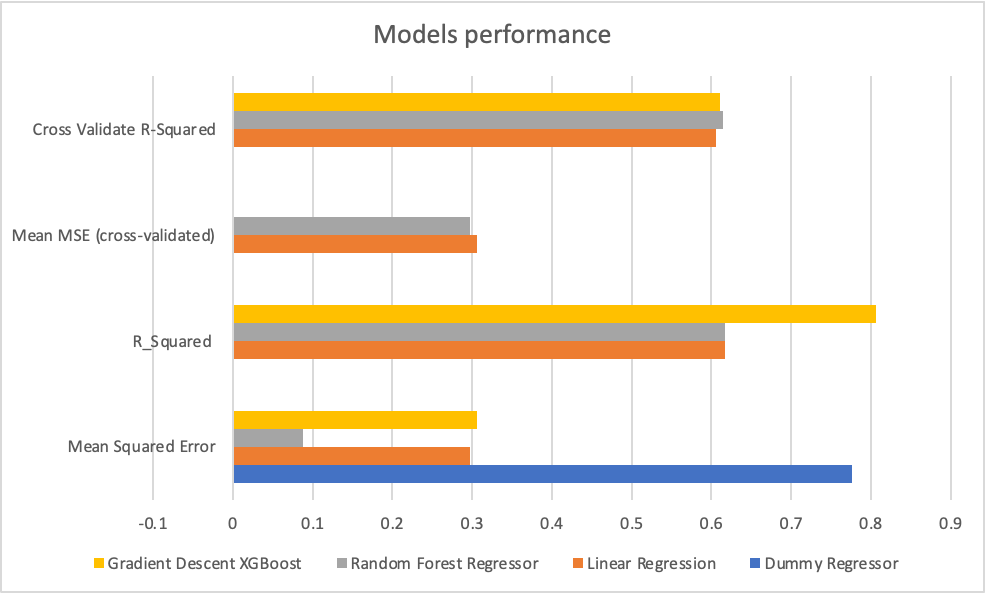


* The Random Forest Regressor model distinguishes itself as the top performer among the assessed models.
  
It archeive the lowest Mean Squared Error (MSE) of 0.0879, signifying superior predictive accuracy compared to alternative models. The R-squared value of 0.6166 indicates that the model explains a substantial portion of the variance in the target variable. The model's robustness is further affirmed by the mean MSE during cross-validation, registering at 0.2973. A consistent performance across different folds is demonstrated by the Cross-validated R-squared of 0.6152.

Therefore, the Random Forest Regressor emerges as the preferred choice for predicting energy consumption in this context. With the selected : 'lotarea,' 'bldgarea,' 'numfloors,' 'unitstotal,' 'assessland,' 'largest property use type - gross floor area (ft²),' 'year built,' 'construction status,' 'number of buildings,' 'occupancy,' 'property gfa - self-reported (ft²),' 'postal code,' 'landuse,' 'comarea,' 'resarea,' 'bldgdepth,' 'lottype,' 'bsmtcode,' 'builtfar,' 'residfar,' 'commfar,' 'facilfar' to make accurate predictions.

## Model performance on the test set

In [110]:

#calculate y_pred_rf  on test set
y_test_pred_rf = rf_model.predict(X_test)

# Evaluate the performance on the test set
mse_test_rf = mean_squared_error(y_test, y_test_pred_rf)
rmse_test_rf = np.sqrt(mse_test_rf)  # Calculate Root Mean Squared Error
r2_test_rf = r2_score(y_test, y_test_pred_rf)

# Print metrics on the test set
print("=== Random Forest Regressor Test Set Metrics ===")
print("Mean Squared Error Test:", mse_test_rf)
print("Root Mean Squared Error Test:", rmse_test_rf)
print("R-squared Test:", r2_test_rf)
print("Model Score (Test):", rf_model.score(X_test, y_test))


=== Random Forest Regressor Test Set Metrics ===
Mean Squared Error Test: 0.29926302935107224
Root Mean Squared Error Test: 0.5470493847460869
R-squared Test: 0.6105072290788536
Model Score (Test): 0.6105072290788536


The test data results provide valuable insights into the generalization performance of the chosen Random Forest Regressor.

* Mean Squared Error (MSE) Test:

The MSE Test value of 0.29926302935107224 indicates the average squared difference between the model's predictions and the actual values on the test data. Lower MSE are preferable, as they suggest that the model predictions are closer to the actual values.

* Root Mean Squared Error (RMSE) Test:
  
The RMSE Test value of 0.5470 is the square root of the MSE and provides an interpretable measure of the average prediction error on the test data. A lower RMSE indicates that, on average, the model's predictions are closer to the actual values.

* R-squared Test:

The R-squared Test value of 0.6105072290788536 measures the proportion of variance in the target variable (energy efficiency) that is explained by the model on the test data. A higher R-squared value suggests that a larger proportion of the variance is captured by the model, indicating good predictive performance.

* Model Score:

The model score, which matches the R-squared Test value, provides an overall assessment of the model's performance on the test data.
A score of 0.6105072290788536 suggests that approximately 61.05% of the variance in the energy efficiency can be explained by the model.

* Interpretation:

The Random Forest Regressor performs reasonably well on the test data, with a competitive R-squared Test value and a relatively low MSE Test.
The model seems to generalize effectively to unseen data, capturing a substantial proportion of the variability in the target variable.
Next Steps:

Consider comparing these results with the performance of other candidate models on the test data to reaffirm the model selection.
Evaluate the business impact of the model's performance and whether it meets the requirements of the real-world problem.
If satisfied with the model's performance, proceed with further steps for deployment and integration into the real-world application.
Overall, the positive performance on the test data strengthens the case for the Random Forest Regressor as a suitable model for solving the energy efficiency prediction problem in this context.

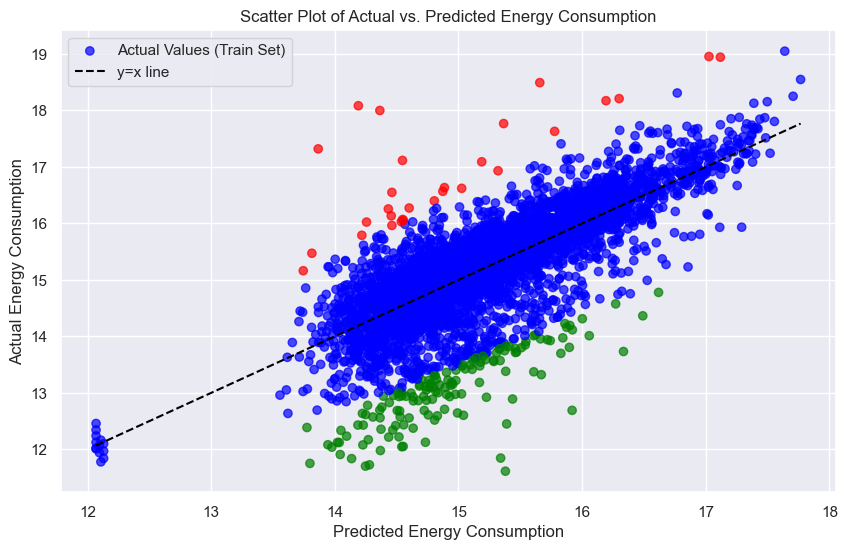

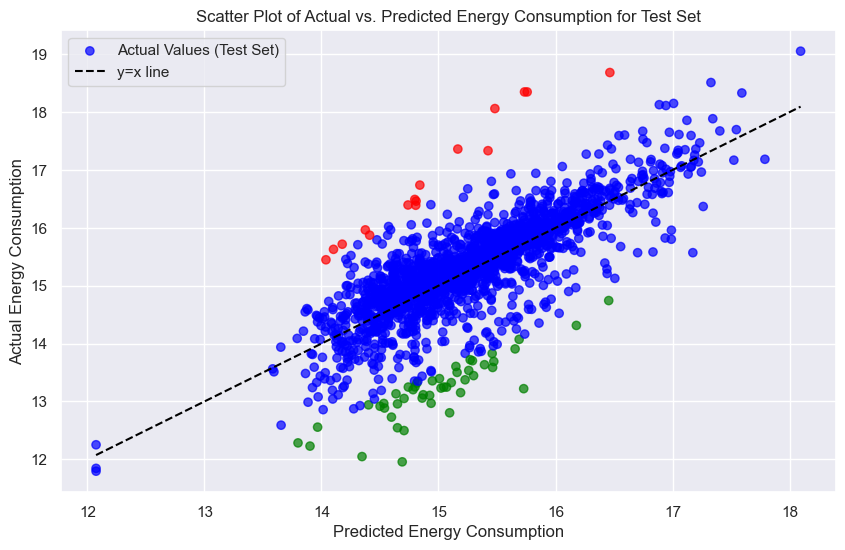

In [74]:
# Extract the actual target values for the train set
y_actual_train = y_train.values 

# Calculate the 10% threshold 
threshold_train = 0.1 * y_pred_cv_rf.max()

# Create an array to store the colors
colors_train = np.where(y_actual_train > 1.1 * y_pred_cv_rf, 'red', np.where(y_actual_train < 0.9 * y_pred_cv_rf, 'green', 'blue'))

# Create the scatter plot for training set
plt.figure(figsize=(10, 6))
plt.scatter(y_pred_cv_rf, y_actual_train, c=colors_train, alpha=0.7, label='Actual Values (Train Set)')
plt.plot([y_pred_cv_rf.min(), y_pred_cv_rf.max()], [y_pred_cv_rf.min(), y_pred_cv_rf.max()], '--', color='black', label='y=x line')
plt.title('Scatter Plot of Actual vs. Predicted Energy Consumption')
plt.xlabel('Predicted Energy Consumption')
plt.ylabel('Actual Energy Consumption')
plt.legend()

# Extract the actual target values for the test set
y_actual_test = y_test.values 

# Calculate the 10% threshold 
threshold_test = 0.1 * y_test_pred_rf.max()

# Create an array to store the colors
colors_test = np.where(y_actual_test > 1.1 * y_test_pred_rf, 'red', np.where(y_actual_test < 0.9 * y_test_pred_rf, 'green', 'blue'))

# Create the scatter plot for test set
plt.figure(figsize=(10, 6))
plt.scatter(y_test_pred_rf, y_actual_test, c=colors_test, alpha=0.7, label='Actual Values (Test Set)')
plt.plot([y_test_pred_rf.min(), y_test_pred_rf.max()], [y_test_pred_rf.min(), y_test_pred_rf.max()], '--', color='black', label='y=x line')
plt.title('Scatter Plot of Actual vs. Predicted Energy Consumption for Test Set')
plt.xlabel('Predicted Energy Consumption')
plt.ylabel('Actual Energy Consumption')
plt.legend()

plt.show()


In the plot above, we display the actual versus predicted energy consumption. The red dots represent buildings with actual energy consumption at least 10% higher than predicted, suggesting a need for improvement in their energy infrastructure. The green dots represent buildings with actual energy consumption 10% lower than predicted, offering insights into potential energy efficiency enhancements. For the majority of buildings, the actual values fall within 10% of the logarithmically transformed predicted energy consumption values. Our model explains 61.5% of the variance in log energy consumption.

## Investigating the highest overuse of energy compared to predictions:

In [ ]:
#let's define a fucntin to identify addresse that have their actual energy consumption hieghst deviation from our predictions.
def identify_outliers(y_actual, y_predicted, top_n=5):
    # Calculate the vertical distance between each point and the y=x line
    vertical_distances1 = y_actual - y_predicted
    vertical_distances2 = y_predicted - y_actual

    # Find the indices of the top N points above and below the predicted values
    top_n_above_indices = np.argsort(vertical_distances2)[:top_n]
    top_n_below_indices = np.argsort(vertical_distances1)[:top_n]

    # Print the indices and corresponding values for the top N above and below
    print(f"Top {top_n} points above the predicted values:")
    for i in top_n_above_indices:
        print(f"Index: {i}, Predicted: {y_predicted[i]}, Actual: {y_actual[i]}")

    print(f"\nTop {top_n} points below the predicted values:")
    for i in top_n_below_indices:
        print(f"Index: {i}, Predicted: {y_predicted[i]}, Actual: {y_actual[i]}")

In [ ]:
##Here wanted to identify addresses that have their actual energy consumption highest deviation from our predictions.
identify_outliers(y_actual_test, y_test_pred_rf, top_n=5)

In [ ]:
#let's define a function to print features that will help us identify the address of the building
#which has  highest level of excess in energy consumption compared to the predicted
def identify_energy_consumption(index_to_check, X_data):
    # Get non-zero values for the specified index
    non_zero_values = X_data.iloc[index_to_check][X_data.iloc[index_to_check] != 0]

    # Print the features and their corresponding values for the specified index
    print(f"Features with highest excess energy consumption for Index {index_to_check}:")
    for column_name, value in non_zero_values.items():
        print(f"Column name: {column_name}, Value: {value}")

In [ ]:
# let's print the features with the highest level of excess energy consumption compared to the predicted.
identify_energy_consumption(1476, X_test)

In [ ]:
def map_address(df, unitstotal, num_buildings, occupancy, bldgdepth, landuse):
    # Define the matching condition
    match_condition = (
        (df['unitstotal'] == unitstotal) &
        (df['number of buildings'] == num_buildings) &
        (df['occupancy'] == occupancy) &
        (df['bldgdepth'] == bldgdepth) &
        (df['landuse'] == landuse)
    )

    # Get the matching rows
    matching_rows = df[match_condition]

    # Get the unique addresses for all matching rows
    unique_addresses = matching_rows['address'].unique()

    # Check if there is a matching address
    if len(unique_addresses) > 0:
        desired_address = unique_addresses[0]

        # Access the value of 'site energy use (kbtu)' for the desired address
        energy_value_str = matching_rows['site energy use (kbtu)'].iloc[0]

        # Convert the value to a numeric type (float)
        try:
            energy_value = float(energy_value_str)

            # Calculate the log value
            log_energy_value = np.log(energy_value)

            # Print the log_energy_value
            print(f"Log of Site Energy Use for {desired_address}: {log_energy_value}")

            # Return the desired address
            return desired_address
        except ValueError:
            return f"Could not convert 'site energy use (kbtu)' value to a numeric type for {desired_address}"
    else:
        return "No matching address found"


In [ ]:
desired_address = map_address(df_a_m, 225.0, 1.0, 100.0, 57.28, 3.0)
desired_address

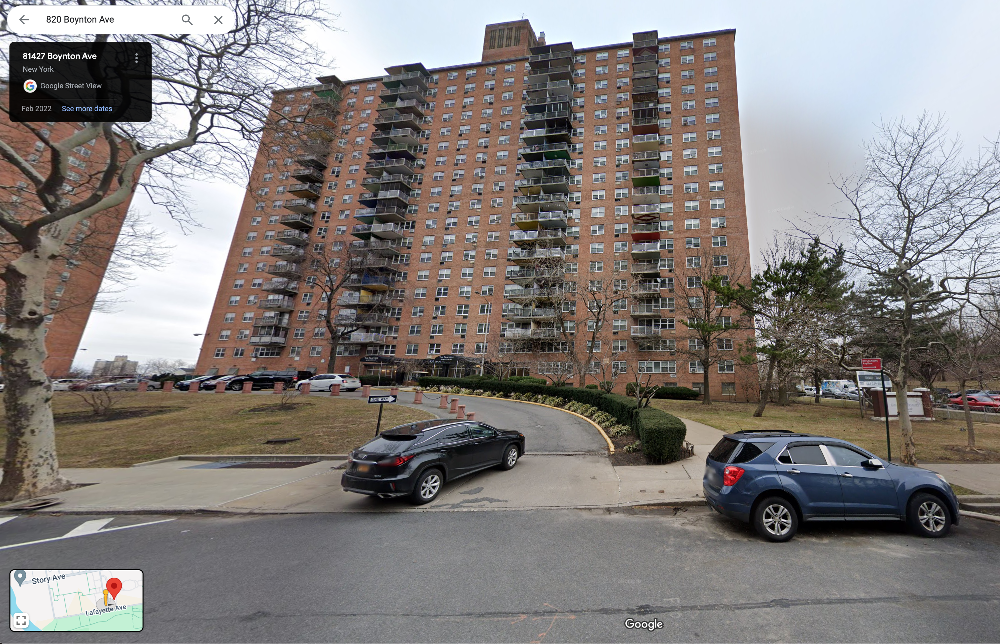

## Investigating the most significant underutilization of energy compared to predictions:

In [ ]:
# let's print the features with the lowest level of excess energy consumption compared to the predicted.
identify_energy_consumption(920, X_test)

In [ ]:
#identifying the address 
desired_address = map_address(df_a_m, 2.0, 1.0, 100.0, 99.0, 8.0)
desired_address

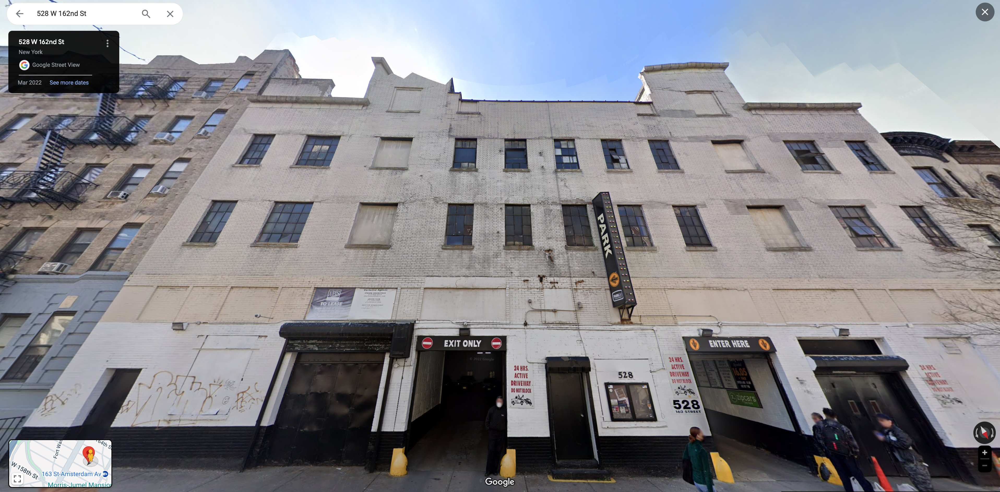

## Conclusion
Considering these achievements, the Random Forest Regressor is strongly recommended for predicting energy consumption in this context. Aligning with the broader business objectives and motivations outlined earlier, the model's exceptional performance offers valuable insights for promoting sustainability, informing policy decisions, and contributing to the overall resilience of the community. The features selected for this model, including 'lotarea,' 'bldgarea,' 'numfloors,' and others, have proven to be instrumental in achieving these significant outcomes.

## Next Steps 
Incorporate More Direct Features: Expand the model's feature set by including more direct features related to energy consumption. Incorporating additional energy-related parameters could enhance the model's predictive power and provide deeper insights into energy efficiency trends.

Develop Property-Specific Models: Explore the development of separate predictive models tailored to different types of property use, such as multi-family housing, hospitals, hotels, etc. Customizing models based on property types can better capture the nuanced factors influencing energy consumption in diverse building types.

Investigate Deviating Buildings: Investigate buildings that exhibit significant deviations from predicted energy consumption levels. Identifying common parameters among these buildings can shed light on underlying factors contributing to energy inefficiency or efficiency. This analysis could inform targeted strategies for energy reduction and optimization.